<a href="https://colab.research.google.com/github/mmanho/Customer-Lifetime-Value-Prediction/blob/main/FINAL_501_7_Google_Analytics_eComm_Data_Lifetime_Value_Project_.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

This notebook provides our creation and training of a customer "lifetime" value model for newly acquired e-commerce customers. 

The notebook references publicly available sample of Analytics 360 data, which is accessible through Google Cloud Platform's BigQuery data warehouse. The data was collected from the Google Merchandise Store, which sells Google promotional products like t-shirts, pens, phone accessories, mugs, etc.

For each newly acquired customer, we have estimated the *future* revenue we can expect from this customer. We made a prediction one week after each customer was acquired to estimate their revenue up to 90 days after their acquisition date. By combining this predicted revenue with the actual revenue generated from the customer's first purchase and any subsequent purchase during their first week, we got a more hollistic view of the value of the acquisition. By providing this value (first transaction revenue + subsequent week 1 revenue + day 8-90 predicted revenue) to Google advertising platforms, Google can automatically optimize digital ads to help acquire higher value new customers.

# **Google Analytics 360**
# New Customer Acquisition Lifetime Value Prediction
### Group 7 Action Learning Project
Lena Capoccia, Hao-Ning Ke, Alyssa Leppert, Rui Min, Isabella Roccograndi, Marie Tran

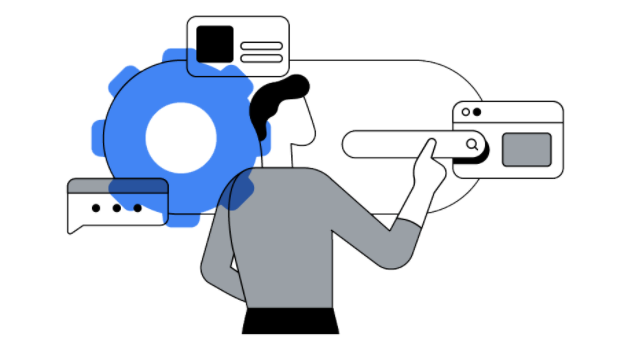

## Creating training, testing & holdout datasets

In [ ]:
# Authenticate using Google OAuth 2.0
# This will provide the credentials necessary to use Google APIs within this notebook (e.g. BigQuery API)
from google.colab import auth
auth.authenticate_user()
print('Authenticated')

Authenticated


In [ ]:
# Query the Analytics 360 sample in BigQuery and store results as a Pandas dataframe
import pandas as pd
import numpy as np
import google.auth
from google.cloud import bigquery
from google.cloud import bigquery_storage

project = 'project-501-7'

credentials, project_id = google.auth.default(
    scopes=["https://www.googleapis.com/auth/cloud-platform"]
)

bqclient = bigquery.Client(credentials=credentials, project=project,)
bqstorageclient = bigquery_storage.BigQueryReadClient(credentials=credentials)

In [ ]:
# The query below finds the first transaction of each customer before 05/01/2017
# It summarizes some information from the session where that transaction occurred (e.g. revenue, time on site, page views, etc.)
# It then summarizes some information from subsequent sessions that happen within 7 days of the first transaction session (e.g. additional visits, additional transactions)
# It then sums any subsequent revenue received from that customer over the next 8-90 days, which will be the target for our model

sql = """

WITH first_purchases AS (
# Find the start time for the session when the customer made their first purchase
SELECT 
    fullVisitorId, # Consider this the customer ID
    MIN(PARSE_TIMESTAMP('%s', CAST(visitStartTime AS string))) firstPurchaseSessionTime # This will show "UTC" as the timezone
FROM 
    `bigquery-public-data.google_analytics_sample.ga_sessions_*`
WHERE
    _TABLE_SUFFIX < '20170501' # We only look at acquisitions before 05/2017 to ensure they all have at least 90 days of subsequent data available
    AND totals.transactions > 0
    AND totals.transactionRevenue > 0
    AND geoNetwork.country = 'United States' # Only looking at US acquisitions so we can assume everything is in USD
GROUP BY
    fullVisitorId
),

first_purchases_sessions AS (
# Get session-level data from the session when the customer made their first purchase
# You'll see later that we have to query session-level data and hit-level data separately
SELECT 
    fp.fullVisitorId,
    ROUND(SUM(totals.transactionRevenue/1000000),2) AS revenue, 
    MAX(visitNumber) AS visitNumber,
    SUM(totals.hits) AS hits,
    SUM(totals.pageviews) AS pageviews,
    COALESCE(SUM(totals.timeOnSite),0) AS timeOnSite,
    MAX(CASE WHEN channelGrouping = 'Referral' THEN 1 ELSE 0 END) AS referralChannelGrouping,
    MAX(CASE WHEN channelGrouping = 'Organic Search' THEN 1 ELSE 0 END) AS organicSearchChannelGrouping,
    MAX(CASE WHEN channelGrouping = 'Direct' THEN 1 ELSE 0 END) AS directChannelGrouping,
    MAX(CASE WHEN channelGrouping = 'Paid Search' THEN 1 ELSE 0 END) AS paidSearchChannelGrouping,
    MAX(CASE WHEN device.browser = 'Chrome' THEN 1 ELSE 0 END) AS chromeBrowser,
    MAX(CASE WHEN device.browser = 'Safari' THEN 1 ELSE 0 END) AS safariBrowser,
    MAX(CASE WHEN device.operatingSystem = 'Macintosh' THEN 1 ELSE 0 END) AS macintoshOS,
    MAX(CASE WHEN device.operatingSystem = 'Windows' THEN 1 ELSE 0 END) AS windowsOS,
    MAX(CASE WHEN device.operatingSystem = 'Chrome OS' THEN 1 ELSE 0 END) AS chromeOS,
    MAX(CASE WHEN device.operatingSystem = 'Linux' THEN 1 ELSE 0 END) AS LinuxOS,
    MAX(CASE WHEN device.isMobile IS TRUE THEN 1 ELSE 0 END) AS isMobile, # dummy variable indicating if the customer was on a mobile device
    MAX(CASE WHEN geoNetwork.region = 'California' THEN 1 ELSE 0 END) AS california, # dummy variable indicating if the customer was in California
    MAX(CASE WHEN geoNetwork.region = 'New York' THEN 1 ELSE 0 END) AS newYork, # dummy variable indicating if the customer was in New York
    MAX(CASE WHEN geoNetwork.metro = 'San Francisco-Oakland-San Jose CA' THEN 1 ELSE 0 END) AS bayArea,

FROM 
    `bigquery-public-data.google_analytics_sample.ga_sessions_*` ga
JOIN
    first_purchases fp
ON
    ga.fullVisitorId = fp.fullVisitorId
    AND PARSE_TIMESTAMP('%s', CAST(ga.visitStartTime AS string)) = fp.firstPurchaseSessionTime # Only getting data from first purchase
WHERE
    _TABLE_SUFFIX < '20170501' 
    AND totals.transactions > 0
    AND totals.transactionRevenue > 0
    AND geoNetwork.country = 'United States'
GROUP BY
    fp.fullVisitorId
),

first_purchases_hits AS (
# Get hit-level data from the session when the customer made their first purchase
# Hit data is stored in nested fields so we have to query it separately from the session-level data or else the session-level data aggregations would be incorrect
# We have reated dummy variables for the maximum number of hits (in a session), maximum product price, and average product price during the session when the customer made their first purchase. 
SELECT 
    fp.fullVisitorId,
    SUM(CASE WHEN hits.eCommerceAction.action_type = '6' THEN product.productQuantity ELSE 0 END) AS productQuantityPurchased, # Product quantity in the final transaction
    MAX(CASE WHEN product.v2ProductCategory = 'Apparel' AND hits.eCommerceAction.action_type = '6' THEN 1 ELSE 0 END) AS apparelPurchased, # dummy variable indicating if any apparel was purchased
    MAX(CASE WHEN product.v2ProductCategory = 'Office' AND hits.eCommerceAction.action_type = '6' THEN 1 ELSE 0 END) AS officePurchased,# dummy variable indicating if any office supplies were purchased
    MAX(CASE WHEN product.v2ProductCategory = 'Drinkware' AND hits.eCommerceAction.action_type = '6' THEN 1 ELSE 0 END) AS drinkwarePurchased,
    MAX(CASE WHEN product.v2ProductCategory = 'Lifestyle' AND hits.eCommerceAction.action_type = '6' THEN 1 ELSE 0 END) AS lifestylePurchased,
    MAX(CASE WHEN product.v2ProductCategory = 'Bags' AND hits.eCommerceAction.action_type = '6' THEN 1 ELSE 0 END) AS bagsPurchased,
    MAX(CASE WHEN product.v2ProductCategory = 'Electronics' AND hits.eCommerceAction.action_type = '6' THEN 1 ELSE 0 END) AS electronicsPurchased,# dummy variable indicating if any electronics were purchased
    MAX(CASE WHEN hits.eCommerceAction.action_type = '4' THEN 1 ELSE 0 END) AS removedItemFromCart, # dummy variable indicating if they removed something from their cart during the session

    ROUND(MAX(product.localProductPrice/1000000),2) AS MaxProdPrice, # created variable for the maximum price (MaxProdPrice) spent on a product by each visitor in U.S. dollars
    ROUND(AVG(product.localProductPrice/1000000),2) AS AvgProdPrice, # created variable for the average price (AvgProdPrice) of the products bought by each visitor in U.S. dollars
    MAX(hitNumber) AS TotalHits, # created variable for the number of hits by each visitor
FROM 
    `bigquery-public-data.google_analytics_sample.ga_sessions_*` ga,
    UNNEST(hits) hits,
    UNNEST(hits.product) product
JOIN
    first_purchases fp
ON
    ga.fullVisitorId = fp.fullVisitorId
    AND PARSE_TIMESTAMP('%s', CAST(ga.visitStartTime AS string)) = fp.firstPurchaseSessionTime # Only getting data from first purchase
WHERE
    _TABLE_SUFFIX < '20170501' 
    AND totals.transactions > 0
    AND totals.transactionRevenue > 0
    AND geoNetwork.country = 'United States'
GROUP BY
    fp.fullVisitorId
),

# Get session level data that occured after the first purchase session but within 7 days of that session
# Looking to see if the user came back within a week and had any additional activity
first_week_sessions AS (
SELECT 
    fp.fullVisitorId,
    COALESCE(SUM(ga.totals.visits),0) AS firstWeekVisits, # Visits from first week of acquisition, excluding acquisition session
    COALESCE(SUM(ga.totals.transactions),0) AS firstWeekTransactions, # Transactions from first week of acquisition, excluding acquisition session
    COALESCE(ROUND(SUM(ga.totals.transactionRevenue/1000000),2),0) AS firstWeekRevenue, # Revenue from first week of acquisition, excluding acquisition session
FROM 
    first_purchases fp
LEFT JOIN
    `bigquery-public-data.google_analytics_sample.ga_sessions_*` ga
ON 
    fp.fullVisitorId = ga.fullVisitorId
    AND TIMESTAMP_DIFF(PARSE_TIMESTAMP('%s', CAST(ga.visitStartTime AS string)), fp.firstPurchaseSessionTime, HOUR) BETWEEN 1 AND 168 # Consider visits between 1 hour and 7 days after first purchase session
GROUP BY 
    fp.fullVisitorId
),

future_purchases AS (
# For each newly acquired customer, look for any purchases that occurred in the next 8-90 days
SELECT
    fp.fullVisitorId,
    ROUND(SUM(ga.totals.transactionRevenue/1000000),2) AS futureRevenue # This is our model target
FROM 
    first_purchases fp
LEFT JOIN
    `bigquery-public-data.google_analytics_sample.ga_sessions_*` ga
ON 
    fp.fullVisitorId = ga.fullVisitorId
    AND TIMESTAMP_DIFF(PARSE_TIMESTAMP('%s', CAST(ga.visitStartTime AS string)), fp.firstPurchaseSessionTime, DAY) BETWEEN 8 AND 90 # Consider purchases between 8-90 days after acquisition
WHERE 
    ga.totals.transactions > 0
    AND totals.transactionRevenue > 0
GROUP BY 
    fp.fullVisitorId
),

## New Dummy Variables of First Purchase Created by Us
# the majority of our new dummy variables were related to time and geographics:

# some variables are generated from subset datasets:
# These subset datasets are records of customers who have made the first purchase
# `project-501-7.507.for_dummy_geonetwork_info` ----- subset datasets including variables fullVisitorId, firstPurchaseSessionTime, Country, Region, City, Metro 
# `project-501-7.507.dummy_fp_morning` ----- subset datasets extracting year, month, hour from firstPurchaseSessionTime. 
#                                            Based on Region and City, timezone(PST, EST, MST, CST) variable is created.
#                                            Using US timezone converter to convert UTC to local time, part of day(morning, afternoon, evening, night) variable is created
# `project-501-7.507.dummyvari_seasonality` ----- subset datasets based on month variable to add seasonal variable(Spring, Summer, Autumn, Winter)
# `project-501-7.507.dummy_season_month` ----- subset datasets including 12 month dummy variables
# Queries of creating new variables in the subset datasets is in the 'Other SQL Queries' part

# we created dummy variables for the various times of day (morning, afternoon, evening, and night) of the first purchase
# we also created dummy variables for US cities
time_zone AS(
SELECT 
    fp.fullVisitorId,
# created 4 dummies for time of day
    MAX(Morning) AS Morning,
    MAX(Afternoon) AS Afternoon,
    MAX(Evening) AS Evening,
    MAX(Night) AS Night,
# created 22 dummies for US city (for those with over 10 records)
    MAX(CASE WHEN City = 'Mountain View' THEN 1 ELSE 0 END) AS MountainView,
    MAX(CASE WHEN City = 'Sunnyvale' THEN 1 ELSE 0 END) AS Sunnyvale,
    MAX(CASE WHEN City = 'Los Angeles' THEN 1 ELSE 0 END) AS LA,
    MAX(CASE WHEN City = 'Chicago' THEN 1 ELSE 0 END) AS Chicago,
    MAX(CASE WHEN City = 'San Francisco' THEN 1 ELSE 0 END) AS SanFran,
    MAX(CASE WHEN City = 'San Jose' THEN 1 ELSE 0 END) AS SanJose,
    MAX(CASE WHEN City = 'Seattle' THEN 1 ELSE 0 END) AS Seattle,
    MAX(CASE WHEN City = 'Austin' THEN 1 ELSE 0 END) AS Austin,
    MAX(CASE WHEN City = 'Santa Clara' THEN 1 ELSE 0 END) AS SantaClara,
    MAX(CASE WHEN City = 'Palo Alto' THEN 1 ELSE 0 END) AS PaloAlto,
    MAX(CASE WHEN City = 'Washington' THEN 1 ELSE 0 END) AS Washington,
    MAX(CASE WHEN City = 'Houston' THEN 1 ELSE 0 END) AS Houston,
    MAX(CASE WHEN City = 'Atlanta' THEN 1 ELSE 0 END) AS Atlanta,
    MAX(CASE WHEN City = 'Kirkland' THEN 1 ELSE 0 END) AS Kirkland,
    MAX(CASE WHEN City = 'San Bruno' THEN 1 ELSE 0 END) AS SanBruno,
    MAX(CASE WHEN City = 'Cambridge' THEN 1 ELSE 0 END) AS Cambridge,
    MAX(CASE WHEN City = 'San Diego' THEN 1 ELSE 0 END) AS SanDiego,
    MAX(CASE WHEN City = 'Pittsburgh' THEN 1 ELSE 0 END) AS Pitt,
    MAX(CASE WHEN City = 'Fremont' THEN 1 ELSE 0 END) AS Fremont,
    MAX(CASE WHEN City = 'Irvine' THEN 1 ELSE 0 END) AS Irvine,
    MAX(CASE WHEN City = 'Boulder' THEN 1 ELSE 0 END) AS Boulder,
    MAX(CASE WHEN City = 'Oakland' THEN 1 ELSE 0 END) AS Oakland,
FROM 
    `project-501-7.507.dummy_fp_morning` tz
JOIN
    first_purchases fp
ON
    tz.fullVisitorId = fp.fullVisitorId
GROUP BY 
    fp.fullVisitorId
),

#then we created dummy variables for the seasons (spring, summer, autumn, winter) from when the first purchase occured
seasonal AS(
SELECT 
    fp.fullVisitorId,
# created 4 seasonal dummies
    MAX(Spring) AS Spring,
    MAX(Summer) AS Summer,
    MAX(Autumn) AS Autumn,
    MAX(Winter) AS Winter,
FROM
    `project-501-7.507.dummyvari_seasonality` s
JOIN
    first_purchases fp
ON
    s.fullVisitorId = fp.fullVisitorId
GROUP BY 
    fp.fullVisitorId
),

#then we created dummy variables for 12 months
month AS(
SELECT 
    fp.fullVisitorId,
 # created 12 month dummies
 # Because there is no visits in June and July, and only 8 visits in May, these months were removed from our model 
    MAX(January) AS January,
    MAX(Febuary) AS Febuary,
    MAX(March) AS March,
    MAX(April) AS April,
    MAX(August) AS August,
    MAX(September) AS September,
    MAX(October) AS October,
    MAX(Novenber) AS November,
    MAX(December) AS December,
FROM 
    `project-501-7.507.dummy_season_month`  m
JOIN
    first_purchases fp
ON
    m.fullVisitorId = fp.fullVisitorId
GROUP BY 
    fp.fullVisitorId
),

# the created dummy variables for the different 15 metro areas
geo_network AS(
SELECT 
    fp.fullVisitorId,
    MAX(CASE WHEN Metro = 'Boston MA-Manchester NH' THEN 1 ELSE 0 END) AS BostonArea,
    MAX(CASE WHEN Metro = 'Dallas-Ft. Worth TX' THEN 1 ELSE 0 END) AS DallasFtWorth,
    MAX(CASE WHEN Metro = 'Houston TX' THEN 1 ELSE 0 END) AS HoustonArea,
    MAX(CASE WHEN Metro = 'Atlanta GA' THEN 1 ELSE 0 END) AS AtlantaArea,
    MAX(CASE WHEN Metro = 'Pittsburgh PA' THEN 1 ELSE 0 END) AS PittsburghArea,
    MAX(CASE WHEN Metro = 'Detroit MI' THEN 1 ELSE 0 END) AS DetroitArea,
    MAX(CASE WHEN Metro = 'San Diego CA' THEN 1 ELSE 0 END) AS SanDiegoArea,
    MAX(CASE WHEN Metro = 'Denver CO' THEN 1 ELSE 0 END) AS DenverArea,
    MAX(CASE WHEN Metro = 'Chicago IL' THEN 1 ELSE 0 END) AS ChicagoArea,
    MAX(CASE WHEN Metro = 'Seattle-Tacoma WA' THEN 1 ELSE 0 END) AS SeattleArea,
    MAX(CASE WHEN Metro = 'Los Angeles CA' THEN 1 ELSE 0 END) AS LAArea,
    MAX(CASE WHEN Metro = 'Austin TX' THEN 1 ELSE 0 END) AS AustinArea,
    MAX(CASE WHEN Metro = 'Roanoke-Lynchburg VA' THEN 1 ELSE 0 END) AS RoanokeArea,
    MAX(CASE WHEN Metro = 'Washington DC (Hagerstown MD)' THEN 1 ELSE 0 END) AS WashDCArea,
    MAX(CASE WHEN Metro = 'Phoenix AZ' THEN 1 ELSE 0 END) AS PhoenixArea,

# created 14 state dummy variables (for those with over 100 records)
    MAX(CASE WHEN Region = 'Texas' THEN 1 ELSE 0 END) AS Texas, 
    MAX(CASE WHEN Region = 'Washington' THEN 1 ELSE 0 END) AS WashingtonRegion, 
    MAX(CASE WHEN Region = 'Illinois' THEN 1 ELSE 0 END) AS Illinois, 
    MAX(CASE WHEN Region = 'Georgia' THEN 1 ELSE 0 END) AS Georgia, 
    MAX(CASE WHEN Region = 'Massachusetts' THEN 1 ELSE 0 END) AS Mass, 
    MAX(CASE WHEN Region = 'District of Columbia' THEN 1 ELSE 0 END) AS DC, 
    MAX(CASE WHEN Region = 'Virginia' THEN 1 ELSE 0 END) AS Virginia, 
    MAX(CASE WHEN Region = 'Michigan' THEN 1 ELSE 0 END) AS Michigan, 
    MAX(CASE WHEN Region = 'Pennsylvania' THEN 1 ELSE 0 END) AS Penn, 
    MAX(CASE WHEN Region = 'Colorado' THEN 1 ELSE 0 END) AS Colorado, 
    MAX(CASE WHEN Region = 'Florida' THEN 1 ELSE 0 END) AS Florida, 
    MAX(CASE WHEN Region = 'North Carolina' THEN 1 ELSE 0 END) AS NCarol, 
    MAX(CASE WHEN Region = 'Arizona' THEN 1 ELSE 0 END) AS Arizona, 
    MAX(CASE WHEN Region = 'New Jersey' THEN 1 ELSE 0 END) AS NewJer, 

# making US coast dummy variables
    MAX(CASE WHEN Region = 'Oregon' THEN 1 
    WHEN Region = 'California' THEN 1
    WHEN Region = 'Washington' THEN 1
        ELSE 0 END) AS westcoast,

MAX(CASE WHEN Region = 'Maine' THEN 1 
    WHEN Region = 'New Hampshire' THEN 1
    WHEN Region = 'Massachusetts' THEN 1
    WHEN Region = 'Rhode Island' THEN 1
    WHEN Region = 'Connecticut' THEN 1
    WHEN Region = 'New York' THEN 1
    WHEN Region = 'New Jersey' THEN 1
    WHEN Region = 'Delaware' THEN 1
    WHEN Region = 'Maryland' THEN 1
    WHEN Region = 'Virginia' THEN 1
    WHEN Region = 'North Carolina' THEN 1
    WHEN Region = 'South Carolina' THEN 1
    WHEN Region = 'Georgia' THEN 1
    WHEN Region = 'Florida' THEN 1
        ELSE 0 END) AS eastcoast,

# creating the main 4 US regions according to the U.S. Census Bureau
MAX(CASE WHEN Region = 'Maine' THEN 1  
    WHEN Region = 'New Hampshire' THEN 1
    WHEN Region = 'Massachusetts' THEN 1
    WHEN Region = 'Rhode Island' THEN 1
    WHEN Region = 'Connecticut' THEN 1
    WHEN Region = 'New York' THEN 1
    WHEN Region = 'New Jersey' THEN 1
    WHEN Region = 'Vermont' THEN 1
    WHEN Region = 'Pennsylvania' THEN 1
        ELSE 0 END) AS northeast,

MAX(CASE  
    WHEN Region = 'Delaware' THEN 1
    WHEN Region = 'Maryland' THEN 1
    WHEN Region = 'Virginia' THEN 1
     WHEN Region = 'West Virginia' THEN 1
     WHEN Region = 'District of Columbia' THEN 1
    WHEN Region = 'North Carolina' THEN 1
    WHEN Region = 'South Carolina' THEN 1
    WHEN Region = 'Georgia' THEN 1
    WHEN Region = 'Florida' THEN 1
    WHEN Region = 'Alabama' THEN 1
    WHEN Region = 'Kentucky' THEN 1
    WHEN Region = 'Mississippi' THEN 1
    WHEN Region = 'Tennessee' THEN 1
    WHEN Region = 'Arkansas' THEN 1
    WHEN Region = 'Louisiana' THEN 1
    WHEN Region = 'Oklahoma' THEN 1
    WHEN Region = 'Texas' THEN 1
        ELSE 0 END) AS south,
  
MAX(CASE WHEN Region = 'Oregon' THEN 1 
    WHEN Region = 'California' THEN 1
    WHEN Region = 'Washington' THEN 1
    WHEN Region = 'Arizona' THEN 1
    WHEN Region = 'Colorado' THEN 1
    WHEN Region = 'Idaho' THEN 1
    WHEN Region = 'New Mexico' THEN 1
    WHEN Region = 'Montana' THEN 1
    WHEN Region = 'Utah' THEN 1
    WHEN Region = 'Nevada' THEN 1
    WHEN Region = 'Wyoming' THEN 1
    WHEN Region = 'Alaska' THEN 1
    WHEN Region = 'Hawaii' THEN 1
        ELSE 0 END) AS west,

MAX(CASE WHEN Region = 'Indiana' THEN 1 
    WHEN Region = 'Illinois' THEN 1
    WHEN Region = 'Michigan' THEN 1
    WHEN Region = 'Ohio' THEN 1
    WHEN Region = 'Wisconsin' THEN 1
    WHEN Region = 'Iowa' THEN 1
    WHEN Region = 'Kansas' THEN 1
    WHEN Region = 'Minnesota' THEN 1
    WHEN Region = 'Missouri' THEN 1
    WHEN Region = 'Nebraska' THEN 1
    WHEN Region = 'North Dakota' THEN 1
    WHEN Region = 'South Dakota' THEN 1
        ELSE 0 END) AS midwest,

# we are now creating location variables for the US divisions as defined by the US Census Bureau
 MAX(CASE WHEN Region = 'Maine' THEN 1  
    WHEN Region = 'New Hampshire' THEN 1
    WHEN Region = 'Massachusetts' THEN 1
    WHEN Region = 'Rhode Island' THEN 1
    WHEN Region = 'Connecticut' THEN 1
    WHEN Region = 'Vermont' THEN 1
        ELSE 0 END) AS newengland,

 MAX(CASE WHEN Region = 'New Jersey' THEN 1 
    WHEN Region = 'New York' THEN 1
    WHEN Region = 'Pennsylvania' THEN 1
        ELSE 0 END) AS midatl,

MAX(CASE WHEN Region = 'Indiana' THEN 1 
    WHEN Region = 'Illinois' THEN 1
    WHEN Region = 'Michigan' THEN 1
    WHEN Region = 'Ohio' THEN 1
    WHEN Region = 'Wisconsin' THEN 1
        ELSE 0 END) AS eastnorthcentr,

MAX(CASE 
    WHEN Region = 'Iowa' THEN 1
    WHEN Region = 'Kansas' THEN 1
    WHEN Region = 'Minnesota' THEN 1
    WHEN Region = 'Missouri' THEN 1
    WHEN Region = 'Nebraska' THEN 1
    WHEN Region = 'North Dakota' THEN 1
    WHEN Region = 'South Dakota' THEN 1
        ELSE 0 END) AS westnorthcentr,

MAX(CASE  
    WHEN Region = 'Delaware' THEN 1
    WHEN Region = 'Maryland' THEN 1
    WHEN Region = 'Virginia' THEN 1
     WHEN Region = 'West Virginia' THEN 1
     WHEN Region = 'District of Columbia' THEN 1
    WHEN Region = 'North Carolina' THEN 1
    WHEN Region = 'South Carolina' THEN 1
    WHEN Region = 'Georgia' THEN 1
    WHEN Region = 'Florida' THEN 1
        ELSE 0 END) AS southatl,
 
MAX(CASE  
       WHEN Region = 'Alabama' THEN 1
    WHEN Region = 'Kentucky' THEN 1
    WHEN Region = 'Mississippi' THEN 1
    WHEN Region = 'Tennessee' THEN 1
        ELSE 0 END) AS eastsouthcentr,

MAX(CASE  
    WHEN Region = 'Arkansas' THEN 1
    WHEN Region = 'Louisiana' THEN 1
    WHEN Region = 'Oklahoma' THEN 1
    WHEN Region = 'Texas' THEN 1
        ELSE 0 END) AS westsouthcentr,
 
MAX(CASE 
    WHEN Region = 'Arizona' THEN 1
    WHEN Region = 'Colorado' THEN 1
    WHEN Region = 'Idaho' THEN 1
    WHEN Region = 'New Mexico' THEN 1
    WHEN Region = 'Montana' THEN 1
    WHEN Region = 'Utah' THEN 1
    WHEN Region = 'Nevada' THEN 1
    WHEN Region = 'Wyoming' THEN 1
        ELSE 0 END) AS mountain,

MAX(CASE WHEN Region = 'Oregon' THEN 1 
    WHEN Region = 'California' THEN 1
    WHEN Region = 'Washington' THEN 1
    WHEN Region = 'Alaska' THEN 1
    WHEN Region = 'Hawaii' THEN 1
        ELSE 0 END) AS pacific,

FROM 
    `project-501-7.507.for_dummy_geonetwork_info` g
JOIN
    first_purchases fp
ON
    g.fullVisitorId = fp.fullVisitorId
GROUP BY 
    fp.fullVisitorId
)

# We then joined the list of newly acquired customers to  
# their acquisition session-level data, acquisition hit-level data, first week session-level data, acquisition geoNetwork-level data and future day 8-90 revenue
SELECT
    first_purchases.*,
    first_purchases_sessions.* EXCEPT(fullVisitorId),
    first_purchases_hits.* EXCEPT(fullVisitorId),
    first_week_sessions.* EXCEPT(fullVisitorId),
    COALESCE(future_purchases.futureRevenue,0) AS futureRevenue,
    time_zone.* EXCEPT(fullVisitorId),
    seasonal.* EXCEPT(fullVisitorId),
    month.* EXCEPT(fullVisitorId),
    geo_network.* EXCEPT(fullVisitorId),
FROM 
    first_purchases
LEFT JOIN 
    first_purchases_sessions 
USING(fullVisitorId)
LEFT JOIN 
    first_purchases_hits 
USING(fullVisitorId)
LEFT JOIN 
    future_purchases 
USING(fullVisitorId)
LEFT JOIN
    first_week_sessions 
USING(fullVisitorId)
LEFT JOIN 
    time_zone 
USING(fullVisitorId)
LEFT JOIN 
    seasonal 
USING(fullVisitorId)
LEFT JOIN 
    month 
USING(fullVisitorId)
LEFT JOIN 
    geo_network 
USING(fullVisitorId)

"""

# Stored query results as Panada dataframe
df = pd.read_gbq(sql, project_id=project, dialect='standard', use_bqstorage_api=True)

/usr/local/lib/python3.7/dist-packages/google/cloud/bigquery_storage_v1beta1/reader.py:603: FutureWarning: Using .astype to convert from timezone-aware dtype to timezone-naive dtype is deprecated and will raise in a future version.  Use obj.tz_localize(None) or obj.tz_convert('UTC').tz_localize(None) instead
  df[column] = pandas.Series(df[column], dtype=dtypes[column])


In [ ]:
# additional dummy variables created for weekday(1)/weekend(0)
import datetime as dt

date = []
actual_date = []
for i in df.firstPurchaseSessionTime:
  weekday = dt.datetime.strftime(i, '%a')
  actual_date.append(weekday)
  if weekday == 'Sat' or weekday == 'Sun':
    weekday = 0
  else:
    weekday = 1
  date.append(weekday)

df['weekDay'] = date


In summary, we added following new variables to our model.


**1. Time dummy variables**
*   Part of day: morning, evening, afternoon, and night
*   Seasonality: Spring, Summer, Autumn, and Winter
*   Month ( May, June and July variables were removed since they have a few records)
*   Day of week: weekday, or weekend

**2. Location dummy variables**
*   Cities in US
*   Metro areas in US
*   States in US
*   West and east coast
*   4 regions: Northeast, Midwest, South, West
*   9 US Divisions


**3.   Numerical variables**
*   Maximum price of the product bought by each visitor in local currency
*   Average price of the product bought by each visitor in local currency
*   The number of hits by each visitor





In [ ]:
df.head()

,fullVisitorId,firstPurchaseSessionTime,revenue,visitNumber,hits,pageviews,timeOnSite,referralChannelGrouping,organicSearchChannelGrouping,directChannelGrouping,...,newengland,midatl,eastnorthcentr,westnorthcentr,southatl,eastsouthcentr,westsouthcentr,mountain,pacific,weekDay
0,443432155573447485,2016-09-11 05:01:40+00:00,9.49,1,44,36,1076,1,0,0,...,0,0,0,0,0,0,0,0,0,0
1,1063651652107093288,2016-10-12 20:00:21+00:00,31.99,53,13,11,229,0,0,1,...,0,0,0,0,0,0,0,0,0,1
2,4786631423539137051,2016-09-07 22:10:45+00:00,137.60,1,40,28,681,0,1,0,...,0,0,0,0,0,0,0,0,0,1
3,8856514354723478027,2016-10-31 19:53:33+00:00,15.99,2,40,30,577,0,1,0,...,0,0,0,0,0,0,0,0,0,1
4,0018400544049332170,2017-03-16 05:36:32+00:00,69.99,1,25,23,509,0,1,0,...,0,0,0,0,0,0,0,0,0,1


In [ ]:
# Created development and holdout datasets
# Dev data will be further split into training and testing data
# The holdout data was used to get a final estimate of the model's performance
dev_data = df[df['firstPurchaseSessionTime'] < '2017-04-01 00:00:00 UTC']
holdout_data = df[df['firstPurchaseSessionTime'] >= '2017-04-01 00:00:00 UTC']

## Exploratory Data Analysis

In [ ]:
#We then explored our existing and new variables
!pip install pycaret
#from pycaret.utils import enable_colab
#enable_colab()
from pycaret.regression import *

In [ ]:
eda_data = dev_data.drop(['fullVisitorId', 'firstPurchaseSessionTime'], axis=1) # Exclude fullVisitorId and firstPurchaseSessionTime from EDA
eda_data = eda_data.reset_index(drop=True)

pc_eda = setup(data = eda_data, target = 'futureRevenue', session_id=123 , profile=True)

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [ ]:
# Our EDA Re-do 

# We decided to be more aggressive in removing outliers
eda_data_v2 = eda_data.drop(
                    eda_data[(eda_data['futureRevenue'] >= 5000.00) # changed from 10000 too 5000
                    | (eda_data['revenue'] >= 5000.00) # changed from 10000 too 5000
                    | (eda_data['visitNumber'] >= 60) # changed from 150 to 60
                    | (eda_data['productQuantityPurchased'] >= 1000) # changed from 1500 to 1000
                    | (eda_data['hits'] >= 400) # added
                    | (eda_data['pageviews'] >= 250 ) # added
                    | (eda_data['firstWeekVisits'] >= 20 ) # added
                    | (eda_data['timeOnSite'] >= 8000 ) # added
                    | (eda_data['MaxProdPrice'] >= 600 ) # added
                    | (eda_data['AvgProdPrice'] >= 300 ) # added
                    | (eda_data['TotalHits'] >= 300 )].index) # added

eda_data_v2 = eda_data_v2.reset_index(drop=True)

# Treat Skewed Data with Log Transformation
eda_data_v2['revenue'] = np.log(eda_data_v2['revenue'])
eda_data_v2['visitNumber'] = np.log(eda_data_v2['visitNumber'])
eda_data_v2['productQuantityPurchased'] = np.log(eda_data_v2['productQuantityPurchased'])
eda_data_v2['hits'] = np.log(eda_data_v2['hits'])
eda_data_v2['pageviews'] = np.log(eda_data_v2['pageviews'])
eda_data_v2['timeOnSite'] = np.log(eda_data_v2['timeOnSite'])
eda_data_v2['MaxProdPrice'] = np.log(eda_data_v2['MaxProdPrice'])
eda_data_v2['AvgProdPrice'] = np.log(eda_data_v2['AvgProdPrice'])
eda_data_v2['TotalHits'] = np.log(eda_data_v2['TotalHits'])

eda_data_v2 = eda_data_v2.drop(eda_data_v2[(eda_data_v2['timeOnSite'] < 0)].index)
eda_data_v2 = eda_data_v2.reset_index(drop=True)

# Re-do EDA
pc_eda_v2 = setup(data = eda_data_v2, target = 'futureRevenue', session_id=123 , profile=True)

eda_data_v2[eda_data_v2.columns[1:]].corr()['futureRevenue'][:-1]

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

visitNumber                0.075139
hits                       0.080345
pageviews                  0.080470
timeOnSite                 0.063231
referralChannelGrouping   -0.032378
                             ...   
southatl                   0.004039
eastsouthcentr             0.058151
westsouthcentr            -0.012778
mountain                  -0.008646
pacific                   -0.038853
Name: futureRevenue, Length: 116, dtype: float64

## Model training

In [ ]:
# Our List of Imported Libraries/Frameworks
import xgboost as xgb
from sklearn.linear_model import LinearRegression, LogisticRegression
from sklearn.tree import DecisionTreeRegressor, DecisionTreeClassifier
from sklearn.ensemble import GradientBoostingRegressor, GradientBoostingClassifier # added
from sklearn.ensemble import RandomForestRegressor, RandomForestClassifier # added
from sklearn.metrics import roc_auc_score, r2_score, precision_score, recall_score, confusion_matrix, classification_report, accuracy_score, f1_score
from sklearn.metrics import mean_squared_error as mse
from sklearn.model_selection import train_test_split
from yellowbrick.regressor import prediction_error
from yellowbrick.regressor import ResidualsPlot 

In [ ]:
# Libraries for OLS Regression
import matplotlib.pyplot as plt 
import seaborn as sns
import statsmodels.api as sm
from sklearn import metrics
import warnings
warnings.filterwarnings('ignore')
%matplotlib inline

In [ ]:
# Statistical Significance Analysis with OLS Regression
x = eda_data_v2[eda_data_v2.columns[eda_data_v2.columns != 'futureRevenue']]
y = eda_data_v2.futureRevenue

x = sm.add_constant(x)
model_stat = sm.OLS(y, x, missing='drop')
results = model_stat.fit()
print(results.summary())

                            OLS Regression Results                            
Dep. Variable:          futureRevenue   R-squared:                       0.107
Model:                            OLS   Adj. R-squared:                  0.093
Method:                 Least Squares   F-statistic:                     8.117
Date:                Wed, 09 Mar 2022   Prob (F-statistic):           3.52e-92
Time:                        03:59:13   Log-Likelihood:                -39537.
No. Observations:                6078   AIC:                         7.925e+04
Df Residuals:                    5989   BIC:                         7.985e+04
Df Model:                          88                                         
Covariance Type:            nonrobust                                         
                                   coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------------------------
const           

Our final prediction can be one of three options:
 - If our regression model is good but our classification model is bad, the prediction will be [Regression Model Prediction] * [Average Repeat Purchase Rate]
 - If our regression model is bad but our classification model is good, the prediction will be [Average futureValue] * [Classification Model Prediction]
 - If our regression model is good and our classification model is good, the prediction will be [Regression Model Prediction] * [Classification Model Prediction]


### Google Initial Model

[03:35:44] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.

Training RMSE:  144.79
Training R-Squared:  0.15

Testing RMSE:  218.25
Testing R-Squared:  0.07

Prediction Error Plot


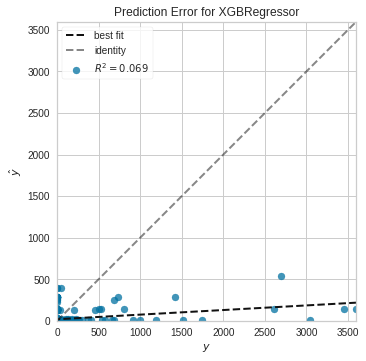

In [ ]:
# Drop the same rows dropped during EDA
dev_data = dev_data.drop(
                    dev_data[(dev_data['futureRevenue'] >= 10000.00) 
                    | (dev_data['revenue'] >= 10000.00)
                    | (dev_data['visitNumber'] >= 150) 
                    | (dev_data['productQuantityPurchased'] >= 1500)].index)

dev_data = dev_data.reset_index(drop=True)

# Setup the data for SK Learn
X = dev_data.drop(['fullVisitorId', 'firstPurchaseSessionTime','futureRevenue'], axis=1) # Feature matrix in pd.DataFrame format...fullVisitorId, session time, and future revenue aren't being used as predictor variables
y = pd.Series(dev_data.futureRevenue) # Target vector in pd.Series format

# Making train and test sets for both X and y
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, 
                                                    random_state=123, shuffle=True)

# Instantiate XGBoost object with hyperparameters...No hyperparameter tuning is included in this example but would be beneficial
model = xgb.XGBRegressor(max_depth=1, n_estimators=20,
                           reg_alpha=10, reg_lambda=0,
                           objectvie='reg:squarederror', booster='gbtree',
                           random_state=123, learning_rate=0.10)

#model = LinearRegression()
#model = DecisionTreeRegressor(max_depth=3)

# Fit the data(train the model)
model.fit(X_train, y_train)

# Calculate RMSE and R^2 for training data
train_y_pred = model.predict(X_train) # Predictions for training data
train_y_true = y_train # True values for training data

Training_MSE = mse(train_y_true, train_y_pred)
Training_RMSE = np.sqrt(Training_MSE)

Training_R_squared = r2_score(train_y_true, train_y_pred)

# Calculate RMSE and R^2 for testing data
test_y_pred = model.predict(X_test) # Predictions for testing data
test_y_true = y_test # True values for testing data

Testing_MSE = mse(test_y_true, test_y_pred)
Testing_RMSE = np.sqrt(Testing_MSE)

Testing_R_squared = r2_score(test_y_true, test_y_pred)

# Print evaluation metrics
print("\nTraining RMSE: ", np.round(Training_RMSE, 2))
print("Training R-Squared: ", np.round(Training_R_squared, 2))

print("\nTesting RMSE: ", np.round(Testing_RMSE, 2))
print("Testing R-Squared: ", np.round(Testing_R_squared, 2))

# Visualize the Prediction Error Plot
print("\nPrediction Error Plot")
viz = prediction_error(model, X_train, y_train, X_test, y_test)
viz.show()

### **Our Models**

####Decision Tree (repeat purchasers only)

In [ ]:
reg_data_dtree = dev_data.drop(
                    dev_data[(dev_data['futureRevenue'] >= 5000.00) # changed from 10000 too 5000
                    | (dev_data['revenue'] >= 5000.00) #changed from 10000 too 5000
                    | (dev_data['visitNumber'] >= 60) #changed from 150 to 60
                    | (dev_data['productQuantityPurchased'] >= 1000) # changed from 1500 to 1000
                    | (dev_data['hits'] >= 400) # added
                    | (dev_data['pageviews'] >= 250 ) #added
                    | (dev_data['firstWeekVisits'] >= 20 ) # added
                    | (dev_data['timeOnSite'] >= 8000 ) #added
                    | (dev_data['MaxProdPrice'] >= 600 ) # added
                    | (dev_data['AvgProdPrice'] >= 300 ) # added
                    | (dev_data['TotalHits'] >= 300 ) # added
                    | (dev_data['futureRevenue'] == 0)].index)

reg_data_dtree = reg_data_dtree.drop(['fullVisitorId', 'firstPurchaseSessionTime'], axis=1) 
reg_data_dtree = reg_data_dtree.reset_index(drop=True)

#Treated Skewed Data with Log Transformation
reg_data_dtree['revenue'] = np.log(reg_data_dtree['revenue'])
reg_data_dtree['visitNumber'] = np.log(reg_data_dtree['visitNumber'])
reg_data_dtree['productQuantityPurchased'] = np.log(reg_data_dtree['productQuantityPurchased'])
reg_data_dtree['hits'] = np.log(reg_data_dtree['hits'])
reg_data_dtree['pageviews'] = np.log(reg_data_dtree['pageviews'])
reg_data_dtree['timeOnSite'] = np.log(reg_data_dtree['timeOnSite'])
reg_data_dtree['MaxProdPrice'] = np.log(reg_data_dtree['MaxProdPrice'])
reg_data_dtree['AvgProdPrice'] = np.log(reg_data_dtree['AvgProdPrice'])
reg_data_dtree['TotalHits'] = np.log(reg_data_dtree['TotalHits'])

# Drop the 2 rows with -inf value 
reg_data_dtree = reg_data_dtree.drop(reg_data_dtree[(reg_data_dtree['timeOnSite'] < 0)].index)
reg_data_dtree = reg_data_dtree.reset_index(drop=True)

In [ ]:
# Finding statistically signficant features 
x = reg_data_dtree[reg_data_dtree.columns[reg_data_dtree.columns != 'futureRevenue']]
y = reg_data_dtree.futureRevenue

x = sm.add_constant(x)
model_stat_dtree = sm.OLS(y, x, missing='drop')
results = model_stat_dtree.fit()
print(results.summary())

                            OLS Regression Results                            
Dep. Variable:          futureRevenue   R-squared:                       0.451
Model:                            OLS   Adj. R-squared:                  0.348
Method:                 Least Squares   F-statistic:                     4.395
Date:                Wed, 09 Mar 2022   Prob (F-statistic):           1.66e-20
Time:                        03:36:40   Log-Likelihood:                -3229.8
No. Observations:                 433   AIC:                             6598.
Df Residuals:                     364   BIC:                             6879.
Df Model:                          68                                         
Covariance Type:            nonrobust                                         
                                   coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------------------------
const           

95% statisically significant: organicSearchChannelGrouping, safariBrowser, productQuantityPurchased, firstWeekRevenue , September, October, southatl, eastsouthcentr

90% statistically significant: Washington, Atlanta, WashDCArea, Georgia, DC, south

In [ ]:
# Feature matrix will include variables statistically significant to futureRevenue at both the 95% and 90% confidence intervals
X = reg_data_dtree[['organicSearchChannelGrouping','safariBrowser','productQuantityPurchased','firstWeekRevenue',
                    'September','October','Washington','Atlanta','WashDCArea','DC','south','southatl',
                    'eastsouthcentr']]
y = pd.Series(reg_data_dtree.futureRevenue) # Target vector in pd.Series format

# Making train and test sets for both X and y
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, 
                                                    random_state=123, shuffle=True)

In [ ]:
# Hyperparameter Tuning with Random Search Algorithm
from sklearn.model_selection import RandomizedSearchCV

params = { 'max_depth': [1, 2, 3, 4, 5, 6],
           'max_leaf_nodes': np.arange(1, 30,1),
           'min_impurity_decrease': np.arange(.1,5,.1), 
           'min_impurity_split': np.arange(.1,5,.1),
           'min_samples_leaf': np.arange(1,30,1),
           'min_samples_split': np.arange(1,20,1),
           'min_weight_fraction_leaf': np.arange(.1,5,.1)}
dt = DecisionTreeRegressor()
dt_best = RandomizedSearchCV(estimator=dt,
                         param_distributions=params,
                         scoring='neg_mean_squared_error',
                         n_iter=1500,
                         verbose=1)
dt_best.fit(X_train, y_train)
print("Best parameters:", dt_best.best_params_)
print("Lowest RMSE: ", (-dt_best.best_score_)**(1/2.0))

Fitting 5 folds for each of 1500 candidates, totalling 7500 fits


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Best parameters: {'min_weight_fraction_leaf': 0.1, 'min_samples_split': 11, 'min_samples_leaf': 3, 'min_impurity_split': 1.2000000000000002, 'min_impurity_decrease': 4.0, 'max_leaf_nodes': 11, 'max_depth': 2}
Lowest RMSE:  492.7043335198253


[Parallel(n_jobs=1)]: Done 7500 out of 7500 | elapsed:   32.2s finished



Training RMSE:  470.41
Training R-Squared:  0.32

Testing RMSE:  433.92
Testing R-Squared:  0.4

Prediction Error Plot


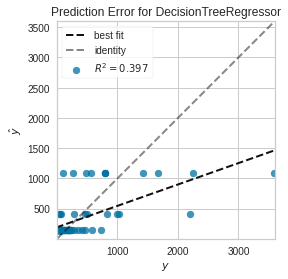

In [ ]:
reg_model_dtree = DecisionTreeRegressor(max_depth=2, min_weight_fraction_leaf=.1, min_samples_split=9, 
                                        min_samples_leaf=28, min_impurity_split=2.0, min_impurity_decrease=0.5, 
                                        max_leaf_nodes=29)


# Fit the data(train the model)
reg_model_dtree.fit(X_train, y_train)

# Get RMSE and R^2 for training data
train_y_pred = reg_model_dtree.predict(X_train) # Predictions for training data
train_y_true = y_train # True values for training data

Training_MSE = mse(train_y_true, train_y_pred)
Training_RMSE = np.sqrt(Training_MSE)

Training_R_squared = r2_score(train_y_true, train_y_pred)

# Get RMSE and R^2 for testing data
test_y_pred = reg_model_dtree.predict(X_test) # Predictions for testing data
test_y_true = y_test # True values for testing data

Testing_MSE = mse(test_y_true, test_y_pred)
Testing_RMSE = np.sqrt(Testing_MSE)

Testing_R_squared = r2_score(test_y_true, test_y_pred)

# Print evaluation metrics
print("\nTraining RMSE: ", np.round(Training_RMSE, 2))
print("Training R-Squared: ", np.round(Training_R_squared, 2))

print("\nTesting RMSE: ", np.round(Testing_RMSE, 2))
print("Testing R-Squared: ", np.round(Testing_R_squared, 2))

# Visualize the Prediction Error Plot
print("\nPrediction Error Plot")
viz = prediction_error(reg_model_dtree, X_train, y_train, X_test, y_test)
viz.show()

##### Classification (likelihood to purchase again)

In [ ]:
cla_data_dtree = dev_data.drop(
                    dev_data[(dev_data['futureRevenue'] >= 5000.00) # changed from 10000 too 5000
                    | (dev_data['revenue'] >= 5000.00) #changed from 10000 too 5000
                    | (dev_data['visitNumber'] >= 60) #changed from 150 to 60
                    | (dev_data['productQuantityPurchased'] >= 1000) # changed from 1500 to 1000
                    | (dev_data['hits'] >= 400) # added
                    | (dev_data['pageviews'] >= 250 ) #added
                    | (dev_data['firstWeekVisits'] >= 20 ) # added
                    | (dev_data['timeOnSite'] >= 8000 )
                    | (dev_data['MaxProdPrice'] >= 600 ) # added
                    | (dev_data['AvgProdPrice'] >= 300 ) # added
                    | (dev_data['TotalHits'] >= 300 )].index) #added

cla_data_dtree = cla_data_dtree.drop(['fullVisitorId', 'firstPurchaseSessionTime'], axis=1) 

cla_data_dtree = cla_data_dtree.reset_index(drop=True)

# Treat Skewed Data with Log Transformation
cla_data_dtree['revenue'] = np.log(cla_data_dtree['revenue'])
cla_data_dtree['visitNumber'] = np.log(cla_data_dtree['visitNumber'])
cla_data_dtree['productQuantityPurchased'] = np.log(cla_data_dtree['productQuantityPurchased'])
cla_data_dtree['hits'] = np.log(cla_data_dtree['hits'])
cla_data_dtree['pageviews'] = np.log(cla_data_dtree['pageviews'])
cla_data_dtree['timeOnSite'] = np.log(cla_data_dtree['timeOnSite'])
cla_data_dtree['MaxProdPrice'] = np.log(cla_data_dtree['MaxProdPrice'])
cla_data_dtree['AvgProdPrice'] = np.log(cla_data_dtree['AvgProdPrice'])
cla_data_dtree['TotalHits'] = np.log(cla_data_dtree['TotalHits'])
# Drop the 2 rows with -inf value 
cla_data_dtree = cla_data_dtree.drop(cla_data_dtree[(cla_data_dtree['timeOnSite'] < 0)].index)
cla_data_dtree = cla_data_dtree.reset_index(drop=True)

In [ ]:
# Added a column to represent a user that purchased again
# This will be our model's target
cla_data_dtree['repeatPurchaser'] = np.where(cla_data_dtree['futureRevenue'] > 0, 1, 0)

dev_data = dev_data.reset_index(drop=True)

In [ ]:
# Found statistically signficant features 
x = cla_data_dtree[cla_data_dtree.columns[cla_data_dtree.columns != 'repeatPurchaser']]
y = cla_data_dtree.repeatPurchaser

x = sm.add_constant(x)
model_stat_dtree_cla = sm.OLS(y, x, missing='drop')
results = model_stat_dtree_cla.fit()
print(results.summary())

                            OLS Regression Results                            
Dep. Variable:        repeatPurchaser   R-squared:                       0.242
Model:                            OLS   Adj. R-squared:                  0.231
Method:                 Least Squares   F-statistic:                     21.47
Date:                Wed, 09 Mar 2022   Prob (F-statistic):          6.18e-290
Time:                        03:38:15   Log-Likelihood:                 470.20
No. Observations:                6078   AIC:                            -760.4
Df Residuals:                    5988   BIC:                            -156.3
Df Model:                          89                                         
Covariance Type:            nonrobust                                         
                                   coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------------------------
const           

95% statisically significant: revenue, visitNumber,  firstWeekVisits, firstWeekTransactions, December

90% statistically significant: Texas, westsouthentr

In [ ]:
# Feature matrix will include variables statistically significant to repeatVisitor (excluding futureRevenue, which we can't use)
X = cla_data_dtree[['revenue','visitNumber','firstWeekVisits','firstWeekTransactions', 'December', 'Texas', 
                    'westsouthcentr']]
y = pd.Series(cla_data_dtree.repeatPurchaser) # Target vector in pd.Series format

# Making train and test sets for both X and y
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, 
                                                    random_state=123, shuffle=True)

In [ ]:
# Hyperparameter Tuning with Random Search Algorithm
from sklearn.model_selection import RandomizedSearchCV

params = { 'max_depth': [1, 2, 3, 4, 5, 6],
           'max_leaf_nodes': np.arange(1, 30,1),
           'min_impurity_decrease': np.arange(.1,5,.1), 
           'min_impurity_split': np.arange(.1,5,.1),
           'min_samples_leaf': np.arange(1,30,1),
           'min_samples_split': np.arange(1,20,1),
           'min_weight_fraction_leaf': np.arange(.1,5,.1)}
dt_cla = DecisionTreeClassifier()
dt_cla_best = RandomizedSearchCV(estimator=dt_cla,
                         param_distributions=params,
                         scoring='neg_mean_squared_error',
                         n_iter=1500,
                         verbose=1)
dt_cla_best.fit(X_train, y_train)
print("Best parameters:", dt_cla_best.best_params_)
print("Lowest RMSE: ", (-dt_cla_best.best_score_)**(1/2.0))

Fitting 5 folds for each of 1500 candidates, totalling 7500 fits


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Best parameters: {'min_weight_fraction_leaf': 0.1, 'min_samples_split': 13, 'min_samples_leaf': 4, 'min_impurity_split': 3.4000000000000004, 'min_impurity_decrease': 1.8000000000000003, 'max_leaf_nodes': 22, 'max_depth': 6}
Lowest RMSE:  0.2601298888525376


[Parallel(n_jobs=1)]: Done 7500 out of 7500 | elapsed:  1.0min finished


In [ ]:
cla_model_dtree = DecisionTreeClassifier(max_depth=6, min_weight_fraction_leaf=.1, min_samples_split=13, 
                                        min_samples_leaf=4, min_impurity_split=3.4, min_impurity_decrease=1.8, 
                                        max_leaf_nodes=22)

# Fit the data(train the model)
cla_model_dtree.fit(X_train, y_train)

# Calculated evaluation metrics for classification model
train_y_pred = cla_model_dtree.predict(X_train) # Predictions for training data
train_y_true = y_train # True values for training data

test_y_pred = cla_model_dtree.predict(X_test) # Predictions for testing data
test_y_true = y_test # True values for testing data

print('\n clasification report:\n', classification_report(test_y_true, test_y_pred))
print('\n confussion matrix:\n',confusion_matrix(test_y_true, test_y_pred))
print('\n ROC AUC: \n',roc_auc_score(test_y_true, test_y_pred))


 clasification report:
               precision    recall  f1-score   support

           0       0.91      1.00      0.96      1112
           1       0.00      0.00      0.00       104

    accuracy                           0.91      1216
   macro avg       0.46      0.50      0.48      1216
weighted avg       0.84      0.91      0.87      1216


 confussion matrix:
 [[1112    0]
 [ 104    0]]

 ROC AUC: 
 0.5


####Random Forest (repeat purchasers only)

In [ ]:
reg_data_rf = dev_data.drop(
                    dev_data[(dev_data['futureRevenue'] >= 5000.00) # changed from 10000 too 5000
                    | (dev_data['revenue'] >= 5000.00) #changed from 10000 too 5000
                    | (dev_data['visitNumber'] >= 60) #changed from 150 to 60
                    | (dev_data['productQuantityPurchased'] >= 1000) # changed from 1500 to 1000
                    | (dev_data['hits'] >= 400) # added
                    | (dev_data['pageviews'] >= 250 ) #added
                    | (dev_data['firstWeekVisits'] >= 20 ) # added
                    | (dev_data['timeOnSite'] >= 8000 ) #added
                    | (dev_data['MaxProdPrice'] >= 600 ) # added
                    | (dev_data['AvgProdPrice'] >= 300 ) # added
                    | (dev_data['TotalHits'] >= 300 ) # added
                    | (dev_data['futureRevenue'] == 0)].index)

reg_data_rf = reg_data_rf.drop(['fullVisitorId', 'firstPurchaseSessionTime'], axis=1) 

reg_data_rf = reg_data_rf.reset_index(drop=True)

# Treat Skewed Data with Log Transformation
reg_data_rf['revenue'] = np.log(reg_data_rf['revenue'])
reg_data_rf['visitNumber'] = np.log(reg_data_rf['visitNumber'])
reg_data_rf['productQuantityPurchased'] = np.log(reg_data_rf['productQuantityPurchased'])
reg_data_rf['hits'] = np.log(reg_data_rf['hits'])
reg_data_rf['pageviews'] = np.log(reg_data_rf['pageviews'])
reg_data_rf['timeOnSite'] = np.log(reg_data_rf['timeOnSite'])
reg_data_rf['MaxProdPrice'] = np.log(reg_data_rf['MaxProdPrice'])
reg_data_rf['AvgProdPrice'] = np.log(reg_data_rf['AvgProdPrice'])
reg_data_rf['TotalHits'] = np.log(reg_data_rf['TotalHits'])
# Drop the 2 rows with -inf value 
reg_data_rf = reg_data_rf.drop(reg_data_rf[(reg_data_rf['timeOnSite'] < 0)].index)
reg_data_rf = reg_data_rf.reset_index(drop=True)

In [ ]:
# Found statistically signficant features 
x = reg_data_rf[reg_data_rf.columns[reg_data_rf.columns != 'futureRevenue']]
y = reg_data_rf.futureRevenue

x = sm.add_constant(x)
model_stat_rf = sm.OLS(y, x, missing='drop')
results = model_stat_rf.fit()
print(results.summary())

                            OLS Regression Results                            
Dep. Variable:          futureRevenue   R-squared:                       0.451
Model:                            OLS   Adj. R-squared:                  0.348
Method:                 Least Squares   F-statistic:                     4.395
Date:                Wed, 09 Mar 2022   Prob (F-statistic):           1.66e-20
Time:                        03:37:05   Log-Likelihood:                -3229.8
No. Observations:                 433   AIC:                             6598.
Df Residuals:                     364   BIC:                             6879.
Df Model:                          68                                         
Covariance Type:            nonrobust                                         
                                   coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------------------------
const           

95% statisically significant: organicSearchChannelGrouping, safariBrowser, productQuantityPurchased, firstWeekRevenue , September, October, southatl, eastsouthcentr

90% statistically significant: Washington, Atlanta, WashDCArea, Georgia, DC, south

In [ ]:
# Feature matrix includes variables statistically significant to futureRevenue
X = reg_data_rf[['organicSearchChannelGrouping','safariBrowser','productQuantityPurchased','firstWeekRevenue',
                 'September','October','Washington','Atlanta','WashDCArea','DC','south','southatl',
                 'eastsouthcentr']]
y = pd.Series(reg_data_rf.futureRevenue) # Target vector in pd.Series format

# Making train and test sets for both X and y
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, 
                                                    random_state=123, shuffle=True)

In [ ]:
# Hyperparameter Tuning with Random Search Algorithm
from sklearn.model_selection import RandomizedSearchCV

params = { 'max_depth': [1, 2, 3, 4, 5, 6],
           'max_leaf_nodes': np.arange(1,100,10),
           'n_estimators': np.arange(100,1000,100),
           'min_impurity_decrease': np.arange(.1,5,.1), 
           'min_impurity_split': np.arange(.1,5,.1),
           'min_samples_leaf': np.arange(1,30,1),
           'min_samples_split': np.arange(1,50,1),
           'min_weight_fraction_leaf':  np.arange(.1,5,.1)}

rf = RandomForestRegressor()
rf_best = RandomizedSearchCV(estimator=rf,
                         param_distributions=params,
                         scoring='neg_mean_squared_error',
                         n_iter=1500,
                         verbose=1)
rf_best.fit(X_train, y_train)
print("Best parameters:", rf_best.best_params_)
print("Lowest RMSE: ", (-rf_best.best_score_)**(1/2.0))

Fitting 5 folds for each of 1500 candidates, totalling 7500 fits


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.



Training RMSE:  466.14
Training R-Squared:  0.33

Testing RMSE:  410.26
Testing R-Squared:  0.45

Prediction Error Plot


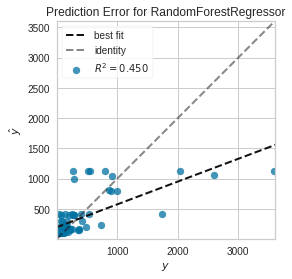

In [ ]:
reg_model_rf = RandomForestRegressor(max_depth=6, n_estimators=100, min_weight_fraction_leaf=.1, min_samples_split=19, 
                                     min_samples_leaf=14, min_impurity_split=2.2, min_impurity_decrease=2.4, 
                                     max_leaf_nodes=31)

# Fit the data(train the model)
reg_model_rf.fit(X_train, y_train)

# Got RMSE and R^2 for training data
train_y_pred = reg_model_rf.predict(X_train) # Predictions for training data
train_y_true = y_train # True values for training data

Training_MSE = mse(train_y_true, train_y_pred)
Training_RMSE = np.sqrt(Training_MSE)

Training_R_squared = r2_score(train_y_true, train_y_pred)

# Got RMSE and R^2 for testing data
test_y_pred = reg_model_rf.predict(X_test) # Predictions for testing data
test_y_true = y_test # True values for testing data

Testing_MSE = mse(test_y_true, test_y_pred)
Testing_RMSE = np.sqrt(Testing_MSE)

Testing_R_squared = r2_score(test_y_true, test_y_pred)

# Print evaluation metrics
print("\nTraining RMSE: ", np.round(Training_RMSE, 2))
print("Training R-Squared: ", np.round(Training_R_squared, 2))

print("\nTesting RMSE: ", np.round(Testing_RMSE, 2))
print("Testing R-Squared: ", np.round(Testing_R_squared, 2))

# Visualize the Prediction Error Plot
print("\nPrediction Error Plot")
viz = prediction_error(reg_model_rf, X_train, y_train, X_test, y_test)
viz.show()

#####Classification (likelihood to purchase again)

In [ ]:
cla_data_rf = dev_data.drop(
                    dev_data[(dev_data['futureRevenue'] >= 5000.00) # changed from 10000 too 5000
                    | (dev_data['revenue'] >= 5000.00) #changed from 10000 too 5000
                    | (dev_data['visitNumber'] >= 60) #changed from 150 to 60
                    | (dev_data['productQuantityPurchased'] >= 1000) # changed from 1500 to 1000
                    | (dev_data['hits'] >= 400) # added
                    | (dev_data['pageviews'] >= 250 ) #added
                    | (dev_data['firstWeekVisits'] >= 20 ) # added
                    | (dev_data['timeOnSite'] >= 8000 ) # added                  
                    | (dev_data['MaxProdPrice'] >= 600 ) # added
                    | (dev_data['AvgProdPrice'] >= 300 ) # added
                    | (dev_data['TotalHits'] >= 300 )].index) #added

# Treat Skewed Data with Log Transformation
cla_data_rf['revenue'] = np.log(cla_data_rf['revenue'])
cla_data_rf['visitNumber'] = np.log(cla_data_rf['visitNumber'])
cla_data_rf['productQuantityPurchased'] = np.log(cla_data_rf['productQuantityPurchased'])
cla_data_rf['hits'] = np.log(cla_data_rf['hits'])
cla_data_rf['pageviews'] = np.log(cla_data_rf['pageviews'])
cla_data_rf['timeOnSite'] = np.log(cla_data_rf['timeOnSite'])
cla_data_rf['MaxProdPrice'] = np.log(cla_data_rf['MaxProdPrice'])
cla_data_rf['AvgProdPrice'] = np.log(cla_data_rf['AvgProdPrice'])
cla_data_rf['TotalHits'] = np.log(cla_data_rf['TotalHits'])
# Drop the 2 rows with -inf value 
cla_data_rf = cla_data_rf.drop(cla_data_rf[(cla_data_rf['timeOnSite'] < 0)].index)
cla_data_rf = cla_data_rf.reset_index(drop=True)

In [ ]:
# Added a column to represent a user that purchased again
# This will be our model's target
cla_data_rf['repeatPurchaser'] = np.where(cla_data_rf['futureRevenue'] > 0, 1, 0)

dev_data = dev_data.reset_index(drop=True)

In [ ]:
# Found statistically signficant features 
x = cla_data_rf[cla_data_rf.columns[cla_data_rf.columns != 'repeatPurchaser']]
y = cla_data_rf.repeatPurchaser

x = sm.add_constant(x)
model_stat_rf_cla = sm.OLS(y, x, missing='drop')
results = model_stat_rf_cla.fit()
print(results.summary())

95% statisically significant: revenue, visitNumber,  firstWeekVisits, firstWeekTransactions, December

90% statistically significant: Texas, westsouthentr

In [ ]:
# Feature matrix includes variables statistically significant to repeatVisitor (excluding futureRevenue, which we can't use)
X = cla_data_rf[['revenue','visitNumber','firstWeekVisits','firstWeekTransactions', 'December', 'Texas', 'westsouthcentr']]
y = pd.Series(cla_data_rf.repeatPurchaser) # Target vector in pd.Series format

# Made train and test sets for both X and y
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, 
                                                    random_state=123, shuffle=True)

In [ ]:
# Hyperparameter Tuning with Random Search Algorithm
from sklearn.model_selection import RandomizedSearchCV

params = { 'max_depth': [1, 2, 3, 4, 5, 6],
           'max_leaf_nodes': np.arange(1,100,10),
           'n_estimators': np.arange(100,1000,100),
           'min_impurity_decrease': np.arange(.1,5,.1), 
           'min_impurity_split': np.arange(.1,5,.1),
           'min_samples_leaf': np.arange(1,30,1),
           'min_samples_split': np.arange(1,50,1),
           'min_weight_fraction_leaf':  np.arange(.1,5,.1)}

rf_cla = RandomForestClassifier()
rf_cla_best = RandomizedSearchCV(estimator=rf_cla,
                         param_distributions=params,
                         scoring='neg_mean_squared_error',
                         n_iter=1500,
                         verbose=1)
rf_cla_best.fit(X_train, y_train)
print("Best parameters:", rf_cla_best.best_params_)
print("Lowest RMSE: ", (-rf_cla_best.best_score_)**(1/2.0))

In [ ]:
cla_model_rf = RandomForestClassifier(max_depth=6, n_estimators=100, min_weight_fraction_leaf=.1, min_samples_split=19, 
                                     min_samples_leaf=14, min_impurity_split=2.2, min_impurity_decrease=2.4, 
                                     max_leaf_nodes=31)
# Fit the data(train the model)
cla_model_rf.fit(X_train, y_train)

# Calculated the evaluation metrics for the classification model
train_y_pred = cla_model_rf.predict(X_train) # Predictions for training data
train_y_true = y_train # True values for training data

test_y_pred = cla_model_rf.predict(X_test) # Predictions for testing data
test_y_true = y_test # True values for testing data

print('\n clasification report:\n', classification_report(test_y_true, test_y_pred))
print('\n confussion matrix:\n',confusion_matrix(test_y_true, test_y_pred))
print('\n ROC AUC: \n',roc_auc_score(test_y_true, test_y_pred))


 clasification report:
               precision    recall  f1-score   support

           0       0.93      1.00      0.96      1128
           1       0.00      0.00      0.00        88

    accuracy                           0.93      1216
   macro avg       0.46      0.50      0.48      1216
weighted avg       0.86      0.93      0.89      1216


 confussion matrix:
 [[1128    0]
 [  88    0]]

 ROC AUC: 
 0.5


####GBM (repeat purchasers only)

In [ ]:
reg_data_gb = dev_data.drop(
                    dev_data[(dev_data['futureRevenue'] >= 5000.00) # changed from 10000 too 5000
                    | (dev_data['revenue'] >= 5000.00) #changed from 10000 too 5000
                    | (dev_data['visitNumber'] >= 60) #changed from 150 to 60
                    | (dev_data['productQuantityPurchased'] >= 1000) # changed from 1500 to 1000
                    | (dev_data['hits'] >= 400) # added
                    | (dev_data['pageviews'] >= 250 ) #added
                    | (dev_data['firstWeekVisits'] >= 20 ) # added
                    | (dev_data['timeOnSite'] >= 8000 ) #added
                    | (dev_data['MaxProdPrice'] >= 600 ) # added
                    | (dev_data['AvgProdPrice'] >= 300 ) # added
                    | (dev_data['TotalHits'] >= 300 ) # added
                    | (dev_data['futureRevenue'] == 0)].index)

reg_data_gb = reg_data_gb.drop(['fullVisitorId', 'firstPurchaseSessionTime'], axis=1) 

reg_data_gb = reg_data_gb.reset_index(drop=True)

# Treated Skewed Data with Log Transformation
reg_data_gb['revenue'] = np.log(reg_data_gb['revenue'])
reg_data_gb['visitNumber'] = np.log(reg_data_gb['visitNumber'])
reg_data_gb['productQuantityPurchased'] = np.log(reg_data_gb['productQuantityPurchased'])
reg_data_gb['hits'] = np.log(reg_data_gb['hits'])
reg_data_gb['pageviews'] = np.log(reg_data_gb['pageviews'])
reg_data_gb['timeOnSite'] = np.log(reg_data_gb['timeOnSite'])
reg_data_gb['MaxProdPrice'] = np.log(reg_data_gb['MaxProdPrice'])
reg_data_gb['AvgProdPrice'] = np.log(reg_data_gb['AvgProdPrice'])
reg_data_gb['TotalHits'] = np.log(reg_data_gb['TotalHits'])
# Drop the 2 rows with -inf value 
reg_data_gb = reg_data_gb.drop(reg_data_gb[(reg_data_gb['timeOnSite'] < 0)].index)
reg_data_gb = reg_data_gb.reset_index(drop=True)

In [ ]:
# Found statistically signficant features 
x = reg_data_gb[reg_data_gb.columns[reg_data_gb.columns != 'futureRevenue']]
y = reg_data_gb.futureRevenue

x = sm.add_constant(x)
model_stat_gb = sm.OLS(y, x, missing='drop')
results = model_stat_gb.fit()
print(results.summary())

                            OLS Regression Results                            
Dep. Variable:          futureRevenue   R-squared:                       0.451
Model:                            OLS   Adj. R-squared:                  0.348
Method:                 Least Squares   F-statistic:                     4.395
Date:                Wed, 09 Mar 2022   Prob (F-statistic):           1.66e-20
Time:                        03:37:36   Log-Likelihood:                -3229.8
No. Observations:                 433   AIC:                             6598.
Df Residuals:                     364   BIC:                             6879.
Df Model:                          68                                         
Covariance Type:            nonrobust                                         
                                   coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------------------------
const           

95% statisically significant: organicSearchChannelGrouping, safariBrowser, productQuantityPurchased, firstWeekRevenue , September, October, southatl, eastsouthcentr

90% statistically significant: Washington, Atlanta, WashDCArea, Georgia, DC, south

In [ ]:
# Feature matrix includes variables statistically significant to futureRevenue
X = reg_data_gb[['organicSearchChannelGrouping','safariBrowser','productQuantityPurchased','firstWeekRevenue',
                 'September','October','Washington','Atlanta','WashDCArea','DC','south','southatl',
                 'eastsouthcentr']]
y = pd.Series(reg_data_gb.futureRevenue) # Target vector in pd.Series format

# Made train and test sets for both X and y
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, 
                                                    random_state=123, shuffle=True)

In [ ]:
# Hyperparameter Tuning with Random Search Algorithm
from sklearn.model_selection import RandomizedSearchCV

params = { 'max_depth': [1, 2, 3, 4, 5, 6],
           'learning_rate': np.arange(0.01, 0.3, .01),
           'subsample': np.arange(0.1, 1.0, 0.1),
           'min_samples_split': np.arange(1,15,1),
           'min_samples_leaf': np.arange(1,20,1),
           'min_weight_fraction_leaf': np.arange(.1,5,.1),
           'min_impurity_decrease': np.arange(.1,5,.1),
           'min_impurity_split': np.arange(.1,5,.1),
           'alpha':np.arange(.01,1,.01),
           'max_leaf_nodes': np.arange(1, 25,1)}

gb = GradientBoostingRegressor()
gb_best = RandomizedSearchCV(estimator=gb,
                         param_distributions=params,
                         scoring='neg_mean_squared_error',
                         n_iter=1000,
                         verbose=1)
gb_best.fit(X_train, y_train)
print("Best parameters:", gb_best.best_params_)
print("Lowest RMSE: ", (-gb_best.best_score_)**(1/2.0))


Training RMSE:  458.34
Training R-Squared:  0.35

Testing RMSE:  422.66
Testing R-Squared:  0.42

Prediction Error Plot


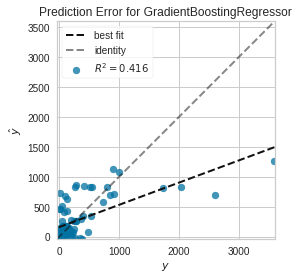

In [ ]:
reg_model_gb = GradientBoostingRegressor(subsample=.1, min_weight_fraction_leaf=0.2,min_samples_split= 10,
                                         min_samples_leaf=7, min_impurity_split=4.0,  min_impurity_decrease= 3.1, 
                                         max_leaf_nodes=8, max_depth=1, learning_rate=0.26, alpha=.88)

# Fit the data(train the model)
reg_model_gb.fit(X_train, y_train)

# Got RMSE and R^2 for training data
train_y_pred = reg_model_gb.predict(X_train) # Predictions for training data
train_y_true = y_train # True values for training data

Training_MSE = mse(train_y_true, train_y_pred)
Training_RMSE = np.sqrt(Training_MSE)

Training_R_squared = r2_score(train_y_true, train_y_pred)

# Got RMSE and R^2 for testing data
test_y_pred = reg_model_gb.predict(X_test) # Predictions for testing data
test_y_true = y_test # True values for testing data

Testing_MSE = mse(test_y_true, test_y_pred)
Testing_RMSE = np.sqrt(Testing_MSE)

Testing_R_squared = r2_score(test_y_true, test_y_pred)

# Print evaluation metrics
print("\nTraining RMSE: ", np.round(Training_RMSE, 2))
print("Training R-Squared: ", np.round(Training_R_squared, 2))

print("\nTesting RMSE: ", np.round(Testing_RMSE, 2))
print("Testing R-Squared: ", np.round(Testing_R_squared, 2))

# Visualize the Prediction Error Plot
print("\nPrediction Error Plot")
viz = prediction_error(reg_model_gb, X_train, y_train, X_test, y_test)
viz.show()

#####Classification (likelihood to purchase again)

In [ ]:
cla_data_gb = dev_data.drop(
                    dev_data[(dev_data['futureRevenue'] >= 5000.00) # changed from 10000 too 5000
                    | (dev_data['revenue'] >= 5000.00) #changed from 10000 too 5000
                    | (dev_data['visitNumber'] >= 60) #changed from 150 to 60
                    | (dev_data['productQuantityPurchased'] >= 1000) # changed from 1500 to 1000
                    | (dev_data['hits'] >= 400) # added
                    | (dev_data['pageviews'] >= 250 ) #added
                    | (dev_data['firstWeekVisits'] >= 20 ) # added
                    | (dev_data['timeOnSite'] >= 8000 ) # added
                    | (dev_data['MaxProdPrice'] >= 600 ) # added
                    | (dev_data['AvgProdPrice'] >= 300 ) # added
                    | (dev_data['TotalHits'] >= 300 )].index) #added

cla_data_gb = cla_data_gb.drop(['fullVisitorId', 'firstPurchaseSessionTime'], axis=1) 

cla_data_gb = cla_data_gb.reset_index(drop=True)

# Treated Skewed Data with Log Transformation
cla_data_gb['revenue'] = np.log(cla_data_gb['revenue'])
cla_data_gb['visitNumber'] = np.log(cla_data_gb['visitNumber'])
cla_data_gb['productQuantityPurchased'] = np.log(cla_data_gb['productQuantityPurchased'])
cla_data_gb['hits'] = np.log(cla_data_gb['hits'])
cla_data_gb['pageviews'] = np.log(cla_data_gb['pageviews'])
cla_data_gb['timeOnSite'] = np.log(cla_data_gb['timeOnSite'])
cla_data_gb['MaxProdPrice'] = np.log(cla_data_gb['MaxProdPrice'])
cla_data_gb['AvgProdPrice'] = np.log(cla_data_gb['AvgProdPrice'])
cla_data_gb['TotalHits'] = np.log(cla_data_gb['TotalHits'])
# Dropped the 2 rows with -inf value 
cla_data_gb = cla_data_gb.drop(cla_data_gb[(cla_data_gb['timeOnSite'] < 0)].index)
cla_data_gb = cla_data_gb.reset_index(drop=True)

In [ ]:
# Add column to represent a user that purchased again
# This will be our model's target
cla_data_gb['repeatPurchaser'] = np.where(cla_data_gb['futureRevenue'] > 0, 1, 0)

dev_data = dev_data.reset_index(drop=True)

In [ ]:
# Found statistically signficant features 
x = cla_data_gb[cla_data_gb.columns[cla_data_gb.columns != 'repeatPurchaser']]
y = cla_data_gb.repeatPurchaser

x = sm.add_constant(x)
model_stat_gb_cla = sm.OLS(y, x, missing='drop')
results = model_stat_gb_cla.fit()
print(results.summary())

                            OLS Regression Results                            
Dep. Variable:        repeatPurchaser   R-squared:                       0.242
Model:                            OLS   Adj. R-squared:                  0.231
Method:                 Least Squares   F-statistic:                     21.47
Date:                Wed, 09 Mar 2022   Prob (F-statistic):          6.18e-290
Time:                        03:39:11   Log-Likelihood:                 470.20
No. Observations:                6078   AIC:                            -760.4
Df Residuals:                    5988   BIC:                            -156.3
Df Model:                          89                                         
Covariance Type:            nonrobust                                         
                                   coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------------------------
const           

95% statisically significant: revenue, visitNumber,  firstWeekVisits, firstWeekTransactions, December

90% statistically significant: Texas, westsouthentr

In [ ]:
# Feature matrix includes variables statistically significant to repeatVisitor (excluding futureRevenue, which we can't use)
X = cla_data_gb[['revenue','visitNumber','firstWeekVisits','firstWeekTransactions', 'December', 'Texas', 'westsouthcentr']]
y = pd.Series(cla_data_gb.repeatPurchaser) # Target vector in pd.Series format

# Makes train and test sets for both X and y
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, 
                                                    random_state=123, shuffle=True)

In [ ]:
# Hyperparameter Tuning with Random Search Algorithm
from sklearn.model_selection import RandomizedSearchCV

params = { 'max_depth': [1, 2, 3, 4, 5, 6],
           'learning_rate': np.arange(0.01, 0.3, .01),
           'subsample': np.arange(0.1, 1.0, 0.1),
           'min_samples_split': np.arange(1,15,1),
           'min_samples_leaf': np.arange(1,20,1),
           'min_weight_fraction_leaf': np.arange(.1,5,.1),
           'min_impurity_decrease': np.arange(.1,5,.1),
           'min_impurity_split': np.arange(.1,5,.1),
           'max_leaf_nodes': np.arange(1, 25,1)}

gb_cla = GradientBoostingClassifier()
gb_cla_best = RandomizedSearchCV(estimator=gb_cla,
                         param_distributions=params,
                         scoring='neg_mean_squared_error',
                         n_iter=1000,
                         verbose=1)
gb_cla_best.fit(X_train, y_train)
print("Best parameters:", gb_cla_best.best_params_)
print("Lowest RMSE: ", (-gb_cla_best.best_score_)**(1/2.0))

Fitting 5 folds for each of 1000 candidates, totalling 5000 fits


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Best parameters: {'subsample': 0.4, 'min_weight_fraction_leaf': 0.30000000000000004, 'min_samples_split': 3, 'min_samples_leaf': 17, 'min_impurity_split': 0.7000000000000001, 'min_impurity_decrease': 4.2, 'max_leaf_nodes': 6, 'max_depth': 3, 'learning_rate': 0.22}
Lowest RMSE:  0.27173122921038845


[Parallel(n_jobs=1)]: Done 5000 out of 5000 | elapsed:  1.3min finished


In [ ]:
cla_model_gb = GradientBoostingClassifier(subsample=.4, min_weight_fraction_leaf=0.3,min_samples_split= 3,
                                         min_samples_leaf=17, min_impurity_split=0.7,  min_impurity_decrease= 4.2, 
                                         max_leaf_nodes=6, max_depth=3, learning_rate=0.22)

# Fit the data(train the model)
cla_model_gb.fit(X_train, y_train)

# Calculated evaluation metrics for our classification model
train_y_pred = cla_model_gb.predict(X_train) # Predictions for training data
train_y_true = y_train # True values for training data

test_y_pred = cla_model_gb.predict(X_test) # Predictions for testing data
test_y_true = y_test # True values for testing data

print('\n clasification report:\n', classification_report(test_y_true, test_y_pred))
print('\n confussion matrix:\n',confusion_matrix(test_y_true, test_y_pred))
print('\n ROC AUC: \n',roc_auc_score(test_y_true, test_y_pred))


 clasification report:
               precision    recall  f1-score   support

           0       0.91      1.00      0.96      1112
           1       0.00      0.00      0.00       104

    accuracy                           0.91      1216
   macro avg       0.46      0.50      0.48      1216
weighted avg       0.84      0.91      0.87      1216


 confussion matrix:
 [[1112    0]
 [ 104    0]]

 ROC AUC: 
 0.5


####XGB (repeat purchasers only)

In [ ]:
reg_data_xgb = dev_data.drop(
                    dev_data[(dev_data['futureRevenue'] >= 5000.00) # changed from 10000 too 5000
                    | (dev_data['revenue'] >= 5000.00) #changed from 10000 too 5000
                    | (dev_data['visitNumber'] >= 60) #changed from 150 to 60
                    | (dev_data['productQuantityPurchased'] >= 1000) # changed from 1500 to 1000
                    | (dev_data['hits'] >= 400) # added
                    | (dev_data['pageviews'] >= 250 ) #added
                    | (dev_data['firstWeekVisits'] >= 20 ) # added
                    | (dev_data['timeOnSite'] >= 8000 ) #added
                    | (dev_data['MaxProdPrice'] >= 600 ) # added
                    | (dev_data['AvgProdPrice'] >= 300 ) # added
                    | (dev_data['TotalHits'] >= 300 ) # added
                    | (dev_data['futureRevenue'] == 0)].index)

reg_data_xgb = reg_data_xgb.drop(['fullVisitorId', 'firstPurchaseSessionTime'], axis=1) 

reg_data_xgb = reg_data_xgb.reset_index(drop=True)

# Treated Skewed Data with Log Transformation
reg_data_xgb['revenue'] = np.log(reg_data_xgb['revenue'])
reg_data_xgb['visitNumber'] = np.log(reg_data_xgb['visitNumber'])
reg_data_xgb['productQuantityPurchased'] = np.log(reg_data_xgb['productQuantityPurchased'])
reg_data_xgb['hits'] = np.log(reg_data_xgb['hits'])
reg_data_xgb['pageviews'] = np.log(reg_data_xgb['pageviews'])
reg_data_xgb['timeOnSite'] = np.log(reg_data_xgb['timeOnSite'])
reg_data_xgb['MaxProdPrice'] = np.log(reg_data_xgb['MaxProdPrice'])
reg_data_xgb['AvgProdPrice'] = np.log(reg_data_xgb['AvgProdPrice'])
reg_data_xgb['TotalHits'] = np.log(reg_data_xgb['TotalHits'])
# Dropped the 2 rows with -inf value 
reg_data_xgb = reg_data_xgb.drop(reg_data_xgb[(reg_data_xgb['timeOnSite'] < 0)].index)
reg_data_xgb = reg_data_xgb.reset_index(drop=True)

In [ ]:
#  Found statistically signficant features 
x = reg_data_xgb[reg_data_xgb.columns[reg_data_xgb.columns != 'futureRevenue']]
y = reg_data_xgb.futureRevenue

x = sm.add_constant(x)
model_stat_xgb = sm.OLS(y, x, missing='drop')
results = model_stat_xgb.fit()
print(results.summary())

                            OLS Regression Results                            
Dep. Variable:          futureRevenue   R-squared:                       0.451
Model:                            OLS   Adj. R-squared:                  0.348
Method:                 Least Squares   F-statistic:                     4.395
Date:                Wed, 09 Mar 2022   Prob (F-statistic):           1.66e-20
Time:                        03:37:52   Log-Likelihood:                -3229.8
No. Observations:                 433   AIC:                             6598.
Df Residuals:                     364   BIC:                             6879.
Df Model:                          68                                         
Covariance Type:            nonrobust                                         
                                   coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------------------------
const           

95% statisically significant: organicSearchChannelGrouping, safariBrowser, productQuantityPurchased, firstWeekRevenue , September, October, southatl, eastsouthcentr

90% statistically significant: Washington, Atlanta, WashDCArea, Georgia, DC, south

In [ ]:
# Feature matrix includes variables statistically significant to futureRevenue
X = reg_data_xgb[['organicSearchChannelGrouping','safariBrowser','productQuantityPurchased','firstWeekRevenue',
                 'September','October','Washington','Atlanta','WashDCArea','DC','south','southatl',
                 'eastsouthcentr']]
y = pd.Series(reg_data_xgb.futureRevenue) # Target vector in pd.Series format

# Made train and test sets for both X and y
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, 
                                                    random_state=123, shuffle=True)

In [ ]:
# Hyperparameter Tuning with Random Search Algorithm
from sklearn.model_selection import RandomizedSearchCV

params = { 'max_depth': [1, 2, 3, 4, 5, 6],
           'learning_rate': np.arange(0.01, 0.3, .01),
           'subsample': np.arange(0.1, 1.0, 0.1),
           'colsample_bytree': np.arange(0.1, 1.0, 0.1),
           'colsample_bylevel': np.arange(0.1, 1.0, 0.1),
           'n_estimators': [100, 500, 1000],
           'reg_alpha': np.arange(1, 100, 1),
           'reg_lambda': np.arange(1, 100, 1)}

xgb = xgb.XGBRegressor()
xgb_best = RandomizedSearchCV(estimator=xgb,
                         param_distributions=params,
                         scoring='neg_mean_squared_error',
                         n_iter=1000,
                         verbose=1)
xgb_best.fit(X_train, y_train)
print("Best parameters:", xgb_best.best_params_)
print("Lowest RMSE: ", (-xgb_best.best_score_)**(1/2.0))

[03:38:07] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.

Training RMSE:  384.19
Training R-Squared:  0.55

Testing RMSE:  422.48
Testing R-Squared:  0.42

Prediction Error Plot


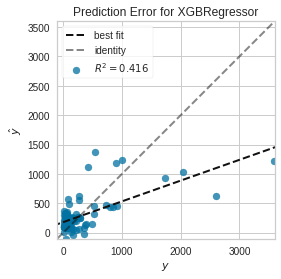

In [ ]:
import xgboost as xgb

reg_model_xgb = xgb.XGBRegressor(subsample=0.1, n_estimators=500, max_depth=2, learning_rate=0.12, 
                                 colsample_bytree=.8, colsample_bylevel=0.8, reg_alpha=38, reg_lambda=8)

# Fit the data(train the model)
reg_model_xgb.fit(X_train, y_train)

# Got RMSE and R^2 for training data
train_y_pred = reg_model_xgb.predict(X_train) # Predictions for training data
train_y_true = y_train # True values for training data

Training_MSE = mse(train_y_true, train_y_pred)
Training_RMSE = np.sqrt(Training_MSE)

Training_R_squared = r2_score(train_y_true, train_y_pred)

# Got RMSE and R^2 for testing data
test_y_pred = reg_model_xgb.predict(X_test) # Predictions for testing data
test_y_true = y_test # True values for testing data

Testing_MSE = mse(test_y_true, test_y_pred)
Testing_RMSE = np.sqrt(Testing_MSE)

Testing_R_squared = r2_score(test_y_true, test_y_pred)

# Print evaluation metrics
print("\nTraining RMSE: ", np.round(Training_RMSE, 2))
print("Training R-Squared: ", np.round(Training_R_squared, 2))

print("\nTesting RMSE: ", np.round(Testing_RMSE, 2))
print("Testing R-Squared: ", np.round(Testing_R_squared, 2))

# Visualize the Prediction Error Plot
print("\nPrediction Error Plot")
viz = prediction_error(reg_model_xgb, X_train, y_train, X_test, y_test)
viz.show()

#####Classification (likelihood to purchase again)

In [ ]:
cla_data_xgb = dev_data.drop(
                    dev_data[(dev_data['futureRevenue'] >= 5000.00) # changed from 10000 too 5000
                    | (dev_data['revenue'] >= 5000.00) #changed from 10000 too 5000
                    | (dev_data['visitNumber'] >= 60) #changed from 150 to 60
                    | (dev_data['productQuantityPurchased'] >= 1000) # changed from 1500 to 1000
                    | (dev_data['hits'] >= 400) # added
                    | (dev_data['pageviews'] >= 250 ) #added
                    | (dev_data['firstWeekVisits'] >= 20 ) # added
                    | (dev_data['timeOnSite'] >= 8000 ) # added
                    | (dev_data['MaxProdPrice'] >= 600 ) # added
                    | (dev_data['AvgProdPrice'] >= 300 ) # added
                    | (dev_data['TotalHits'] >= 300 )].index) #added

cla_data_xgb = cla_data_xgb.drop(['fullVisitorId', 'firstPurchaseSessionTime'], axis=1) 

cla_data_xgb = cla_data_xgb.reset_index(drop=True)

# Treated Skewed Data with Log Transformation
cla_data_xgb['revenue'] = np.log(cla_data_xgb['revenue'])
cla_data_xgb['visitNumber'] = np.log(cla_data_xgb['visitNumber'])
cla_data_xgb['productQuantityPurchased'] = np.log(cla_data_xgb['productQuantityPurchased'])
cla_data_xgb['hits'] = np.log(cla_data_xgb['hits'])
cla_data_xgb['pageviews'] = np.log(cla_data_xgb['pageviews'])
cla_data_xgb['timeOnSite'] = np.log(cla_data_xgb['timeOnSite'])
cla_data_xgb['MaxProdPrice'] = np.log(cla_data_xgb['MaxProdPrice'])
cla_data_xgb['AvgProdPrice'] = np.log(cla_data_xgb['AvgProdPrice'])
cla_data_xgb['TotalHits'] = np.log(cla_data_xgb['TotalHits'])
# Dropped the 2 rows with -inf value 
cla_data_xgb = cla_data_xgb.drop(cla_data_xgb[(cla_data_xgb['timeOnSite'] < 0)].index)
cla_data_xgb = cla_data_xgb.reset_index(drop=True)

In [ ]:
# Added column to represent a user that purchased again
# This will be our model's target
cla_data_xgb['repeatPurchaser'] = np.where(cla_data_xgb['futureRevenue'] > 0, 1, 0)

dev_data = dev_data.reset_index(drop=True)

In [ ]:
# Found statistically signficant features 
x = cla_data_xgb[cla_data_xgb.columns[cla_data_xgb.columns != 'repeatPurchaser']]
y = cla_data_xgb.repeatPurchaser

x = sm.add_constant(x)
model_stat_xgb_cla = sm.OLS(y, x, missing='drop')
results = model_stat_xgb_cla.fit()
print(results.summary())

                            OLS Regression Results                            
Dep. Variable:        repeatPurchaser   R-squared:                       0.242
Model:                            OLS   Adj. R-squared:                  0.231
Method:                 Least Squares   F-statistic:                     21.47
Date:                Wed, 09 Mar 2022   Prob (F-statistic):          6.18e-290
Time:                        03:39:20   Log-Likelihood:                 470.20
No. Observations:                6078   AIC:                            -760.4
Df Residuals:                    5988   BIC:                            -156.3
Df Model:                          89                                         
Covariance Type:            nonrobust                                         
                                   coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------------------------
const           

95% statisically significant: revenue, visitNumber,  firstWeekVisits, firstWeekTransactions, December

90% statistically significant: Texas, westsouthentr

In [ ]:
# Feature matrix includes variables statistically significant to repeatVisitor (excluding futureRevenue, which we can't use)
X = cla_data_xgb[['revenue','visitNumber','firstWeekVisits','firstWeekTransactions', 'December', 'Texas', 'westsouthcentr']]
y = pd.Series(cla_data_xgb.repeatPurchaser) # Target vector in pd.Series format

# Made train and test sets for both X and y
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, 
                                                    random_state=123, shuffle=True)

In [ ]:
# Hyperparameter Tuning with Random Search Algorithm
from sklearn.model_selection import RandomizedSearchCV

params = { 'max_depth': [1, 2, 3, 4, 5, 6],
           'learning_rate': np.arange(0.01, 0.3, .01),
           'subsample': np.arange(0.1, 1.0, 0.1),
           'colsample_bytree': np.arange(0.1, 1.0, 0.1),
           'colsample_bylevel': np.arange(0.1, 1.0, 0.1),
           'n_estimators': [100, 500, 1000],
           'reg_alpha': np.arange(1, 100, 1),
           'reg_lambda': np.arange(1, 100, 1)}

xgb_cla = xgb.XGBClassifier()
xgb_cla_best = RandomizedSearchCV(estimator=xgb_cla,
                         param_distributions=params,
                         scoring='neg_mean_squared_error',
                         n_iter=1000,
                         verbose=1)
xgb_cla_best.fit(X_train, y_train)
print("Best parameters:", xgb_cla_best.best_params_)
print("Lowest RMSE: ", (-xgb_cla_best.best_score_)**(1/2.0))

Fitting 5 folds for each of 1000 candidates, totalling 5000 fits


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done 5000 out of 5000 | elapsed: 39.6min finished


Best parameters: {'subsample': 0.9, 'reg_lambda': 51, 'reg_alpha': 40, 'n_estimators': 500, 'max_depth': 4, 'learning_rate': 0.28, 'colsample_bytree': 0.5, 'colsample_bylevel': 0.9}
Lowest RMSE:  0.2601298888525376


In [ ]:
cla_model_xgb = xgb.XGBClassifier(subsample=0.1, n_estimators=500, max_depth=2, learning_rate=0.12, 
                                 colsample_bytree=.8, colsample_bylevel=0.8, reg_alpha=38, reg_lambda=8)

# Fit the data(train the model)
cla_model_xgb.fit(X_train, y_train)

# Calculated evaluation metrics for our classification model
train_y_pred = cla_model_xgb.predict(X_train) # Predictions for training data
train_y_true = y_train # True values for training data

test_y_pred = cla_model_xgb.predict(X_test) # Predictions for testing data
test_y_true = y_test # True values for testing data


print('\n clasification report:\n', classification_report(test_y_true, test_y_pred))
print('\n confussion matrix:\n',confusion_matrix(test_y_true, test_y_pred))
print('\n ROC AUC: \n',roc_auc_score(test_y_true, test_y_pred))


 clasification report:
               precision    recall  f1-score   support

           0       0.93      1.00      0.96      1128
           1       0.00      0.00      0.00        88

    accuracy                           0.93      1216
   macro avg       0.46      0.50      0.48      1216
weighted avg       0.86      0.93      0.89      1216


 confussion matrix:
 [[1128    0]
 [  88    0]]

 ROC AUC: 
 0.5


## Holdout predictions

We used the following process established in the sample script to start with and then adapted the process to accomodate all of our models:

"As a final step, I'm comparing different options for making a prediction to a "naive estimate." The three options I will consider for making a prediction are:
- Naive estimate, which assumes each customer's 8-90 day future revenue will be equal to the average future revenue observed in the development dataset.
- Initial model's predictions. This was the first model with the low R-squared.
- Regression only model, which will take the predictions from the regression model trained on repeat purchasers multiplied by the average repeat purchase rate observered in the development dataset. 

Note, I did not consider any options using the classification model since that model's performance was very poor. If you can create a classification model with better performance, I would suggest you try using it here.

I will evaluate the model based on three metrics:
- Mean absolute error, the primary KPI
- Mean squared error, which is more sensitive to extreme errors
- Average error, which will indicate overall prediction bias" 

In [ ]:
# Treatment of outliers
holdout_data  = holdout_data .drop(
                    holdout_data [(holdout_data ['futureRevenue'] >= 5000.00) # changed from 10000 too 5000
                    | (holdout_data ['revenue'] >= 5000.00) #changed from 10000 too 5000
                    | (holdout_data ['visitNumber'] >= 60) #changed from 150 to 60
                    | (holdout_data ['productQuantityPurchased'] >= 1000) # changed from 1500 to 1000
                    | (holdout_data ['hits'] >= 400) # added
                    | (holdout_data ['pageviews'] >= 250 ) #added
                    | (holdout_data ['firstWeekVisits'] >= 20 ) # added
                    | (holdout_data ['timeOnSite'] >= 8000 ) #added
                    | (holdout_data ['MaxProdPrice'] >= 600 ) # added
                    | (holdout_data ['AvgProdPrice'] >= 300 ) # added
                    | (holdout_data ['TotalHits'] >= 300 )].index)
holdout_data  = holdout_data.drop(['fullVisitorId', 'firstPurchaseSessionTime'], axis=1) 
holdout_data  = holdout_data.reset_index(drop=True)

# Log Transformation to Holdout Data
holdout_data ['revenue'] = np.log(holdout_data['revenue'])
holdout_data['visitNumber'] = np.log(holdout_data['visitNumber'])
holdout_data['productQuantityPurchased'] = np.log(holdout_data['productQuantityPurchased'])
holdout_data['hits'] = np.log(holdout_data['hits'])
holdout_data['pageviews'] = np.log(holdout_data['pageviews'])
holdout_data['timeOnSite'] = np.log(holdout_data['timeOnSite'])
holdout_data['MaxProdPrice'] = np.log(holdout_data['MaxProdPrice'])
holdout_data['AvgProdPrice'] = np.log(holdout_data['AvgProdPrice'])
holdout_data['TotalHits'] = np.log(holdout_data['TotalHits'])

In [ ]:
# Holdout Predictions with Our Models

# Calculated average repeat purchase rate from development dataset
dev_data['repeatPurchaser'] = np.where(dev_data['futureRevenue'] > 0, 1, 0)
AvgRepeat = np.mean(dev_data['repeatPurchaser'])

# Calculated average future revenue observed in the development dataset
AvgCLV = np.mean(dev_data['futureRevenue']) 

# Created naive estimate for all customers, which is equal to average future revenue from development dataset
holdout_data['NaiveEstimate'] = AvgCLV 

# Set up holdout data for Google initial model
X_holdout = holdout_data.drop(['fullVisitorId', 'firstPurchaseSessionTime','futureRevenue','NaiveEstimate'], axis=1) 
y_holdout = pd.Series(holdout_data.futureRevenue)

holdout_y_pred = model.predict(X_holdout) # Initial model predictions for holdout data
holdout_y_true = y_holdout # True values for holdout data

# Set up data for Decision Tree regression only model
reg_X_holdout_dt = holdout_data[['organicSearchChannelGrouping','safariBrowser','productQuantityPurchased',
                                 'firstWeekRevenue','September','October','Washington','Atlanta','WashDCArea',
                                 'DC','south','southatl','eastsouthcentr']]

reg_holdout_y_pred_dt = reg_model_dtree.predict(reg_X_holdout_dt) * AvgRepeat # Regression only predictions for holdout data

# Set up data for Random Forest regression only model
reg_X_holdout_rf = holdout_data[['organicSearchChannelGrouping','safariBrowser','productQuantityPurchased',
                                 'firstWeekRevenue','September','October','Washington','Atlanta','WashDCArea',
                                 'DC','south','southatl','eastsouthcentr']]

reg_holdout_y_pred_rf = reg_model_rf.predict(reg_X_holdout_rf) * AvgRepeat # Regression only predictions for holdout data

# Set up data for GBM regression only model
reg_X_holdout_gb = holdout_data[['organicSearchChannelGrouping','safariBrowser','productQuantityPurchased',
                                 'firstWeekRevenue','September','October','Washington','Atlanta','WashDCArea',
                                 'DC','south','southatl','eastsouthcentr']]

reg_holdout_y_pred_gb = reg_model_gb.predict(reg_X_holdout_gb) * AvgRepeat # Regression only predictions for holdout data

# Set up data for XGB regression only model
reg_X_holdout_xgb = holdout_data[['organicSearchChannelGrouping','safariBrowser','productQuantityPurchased',
                                 'firstWeekRevenue','September','October','Washington','Atlanta','WashDCArea',
                                 'DC','south','southatl','eastsouthcentr']]

reg_holdout_y_pred_xgb = reg_model_xgb.predict(reg_X_holdout_xgb) * AvgRepeat # Regression only predictions for holdout data

# Got RMSE and MAE error based on naive estimate
Naive_MAE = np.mean(np.absolute(pd.Series(holdout_data.NaiveEstimate) - holdout_y_true))
Naive_MSE = mse(pd.Series(holdout_data.NaiveEstimate), holdout_y_true)
Naive_RMSE = np.sqrt(Naive_MSE)
Naive_Avg_Error = np.mean(pd.Series(holdout_data.NaiveEstimate) - holdout_y_true)

# Got RMSE, MAE, and average error based on Google initial model predictions
Google_Initial_Model_MAE = np.mean(np.absolute(holdout_y_true - holdout_y_pred))
Google_Initial_Model_MSE = mse(holdout_y_true, holdout_y_pred)
Google_Initial_Model_RMSE = np.sqrt(Google_Initial_Model_MSE)
Google_Initial_Model_Avg_Error = np.mean(holdout_y_true - holdout_y_pred)

# Got RMSE and MAE error based on Decision Tree regression only model
DT_Reg_Model_MAE = np.mean(np.absolute(holdout_y_true - reg_holdout_y_pred_dt))
DT_Reg_Model_MSE = mse(holdout_y_true, reg_holdout_y_pred_dt)
DT_Reg_Model_RMSE = np.sqrt(DT_Reg_Model_MSE)
DT_Reg_Model_Avg_Error = np.mean(reg_holdout_y_pred_dt - holdout_y_true)

# Got RMSE and MAE error based on Random Forest regression only model
RF_Reg_Model_MAE = np.mean(np.absolute(holdout_y_true - reg_holdout_y_pred_rf))
RF_Reg_Model_MSE = mse(holdout_y_true, reg_holdout_y_pred_rf)
RF_Reg_Model_RMSE = np.sqrt(RF_Reg_Model_MSE)
RF_Reg_Model_Avg_Error = np.mean(reg_holdout_y_pred_rf - holdout_y_true)

# Got RMSE and MAE error based on GBM regression only model
GBM_Reg_Model_MAE = np.mean(np.absolute(holdout_y_true - reg_holdout_y_pred_gb))
GBM_Reg_Model_MSE = mse(holdout_y_true, reg_holdout_y_pred_gb)
GBM_Reg_Model_RMSE = np.sqrt(GBM_Reg_Model_MSE)
GBM_Reg_Model_Avg_Error = np.mean(reg_holdout_y_pred_gb - holdout_y_true)

# Got RMSE and MAE error based on XGB regression only model
XGB_Reg_Model_MAE = np.mean(np.absolute(holdout_y_true - reg_holdout_y_pred_xgb))
XGB_Reg_Model_MSE = mse(holdout_y_true, reg_holdout_y_pred_xgb)
XGB_Reg_Model_RMSE = np.sqrt(XGB_Reg_Model_MSE)
XGB_Reg_Model_Avg_Error = np.mean(reg_holdout_y_pred_xgb - holdout_y_true)

print("\nNaive MAE: ", np.round(Naive_MAE, 2))
print("Naive RMSE: ", np.round(Naive_RMSE, 2))
print("Naive Avg Error: ", np.round(Naive_Avg_Error, 2))

print("\nGoogle Initial Model MAE: ", np.round(Google_Initial_Model_MAE, 2))
print("Google Initial Model RMSE: ", np.round(Google_Initial_Model_RMSE, 2))
print("Google Initial Model Avg Error: ", np.round(Google_Initial_Model_Avg_Error, 2))

print("\nDecision Tree Regression Only Model MAE: ", np.round(DT_Reg_Model_MAE, 2))
print("Decision Tree Regression Only Model RMSE: ", np.round(DT_Reg_Model_RMSE, 2))
print("Decision Tree Regression Only Model Avg Error: ", np.round(DT_Reg_Model_Avg_Error, 2))

print("\nRandom Forest Regression Only Model MAE: ", np.round(RF_Reg_Model_MAE, 2))
print("Random Forest Regression Only Model RMSE: ", np.round(RF_Reg_Model_RMSE, 2))
print("Random Forest Regression Only Model Avg Error: ", np.round(RF_Reg_Model_Avg_Error, 2))

print("\nGBM Regression Only Model MAE: ", np.round(GBM_Reg_Model_MAE, 2))
print("GBM Regression Only Model RMSE: ", np.round(GBM_Reg_Model_RMSE, 2))
print("GBM Regression Only Model Avg Error: ", np.round(GBM_Reg_Model_Avg_Error, 2))

print("\nXGB Regression Only Model MAE: ", np.round(XGB_Reg_Model_MAE, 2))
print("XGB Regression Only Model RMSE: ", np.round(XGB_Reg_Model_RMSE, 2))
print("XGB Regression Only Model Avg Error: ", np.round(XGB_Reg_Model_Avg_Error, 2))


Naive MAE:  31.59
Naive RMSE:  70.2
Naive Avg Error:  10.83

Google Initial Model MAE:  21.36
Google Initial Model RMSE:  67.47
Google Initial Model Avg Error:  0.1

Decision Tree Regression Only Model MAE:  24.0
Decision Tree Regression Only Model RMSE:  69.46
Decision Tree Regression Only Model Avg Error:  2.18

Random Forest Regression Only Model MAE:  23.08
Random Forest Regression Only Model RMSE:  69.47
Random Forest Regression Only Model Avg Error:  1.21

GBM Regression Only Model MAE:  19.18
GBM Regression Only Model RMSE:  69.91
GBM Regression Only Model Avg Error:  -3.76

XGB Regression Only Model MAE:  20.73
XGB Regression Only Model RMSE:  69.35
XGB Regression Only Model Avg Error:  -1.69


In [ ]:
pc_holdout = setup(data = holdout_data, target = 'futureRevenue', session_id=123 , profile=True)

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

As you can see in the results above, the **Gradient Boosting Model (GBM)** had the lowest MAE. Therefore, we have selected this model for our analysis.

## Other SQL Queries
####This is the code we used to define some the variables we created earlier in this script.

In [ ]:
# Query to define timezone
sql='''
UPDATE `project-501-7.507.Split_firstpurchasetime`
SET time_zone='PST'
WHERE Region in ('California','Nevada','Oregon','Washington')

UPDATE `project-501-7.507.Split_firstpurchasetime`
SET time_zone='CST'
WHERE Region in('Illinois','Iowa','Minnesota','Missouri','Tennessee','Texas')

UPDATE `project-501-7.507.Split_firstpurchasetime`
SET time_zone='EST'
WHERE Region in  ('Connecticut','District of Columbia','Florida','Georgia','Indiana','Massachusetts','Michigan','New Jersey','New York','North Carolina','Ohio','Pennsylvania','South Carolina','Virginia')

UPDATE `project-501-7.507.Split_firstpurchasetime`
SET time_zone='MST'
WHERE Region in ('Arizona','Colorado','Texas','Utah')
'''

# Query to split firstPurchaseSessionTime
sql='''
WITH split_time AS (
SELECT
  fullVisitorId,
  firstPurchaseSessionTime,
  EXTRACT(MONTH FROM  firstPurchaseSessionTime) AS month,
  EXTRACT(WEEK FROM   firstPurchaseSessionTime) AS week,
  EXTRACT(TIME FROM   firstPurchaseSessionTime) AS time,
  EXTRACT(DATE FROM   firstPurchaseSessionTime) AS date,
  EXTRACT(HOUR FROM   firstPurchaseSessionTime) AS hour,

FROM 
 `project-501-7.507.for_dummy_geonetwork_info` 
GROUP BY 
fullVisitorId,firstPurchaseSessionTime
),

origin as(
SELECT *
FROM 
 `project-501-7.507.for_dummy_geonetwork_info` 

)

SELECT
    origin.*,
    split_time.* EXCEPT(fullVisitorId,firstPurchaseSessionTime),
FROM 
    origin
LEFT JOIN 
    split_time 
USING(fullVisitorId)

'''

# Query to create part of day
sql='''
WITH part_day AS (
SELECT 
    fullVisitorId,
    
    MAX(
    CASE TimeZone 
    WHEN'MST' THEN 
    (CASE WHEN fp_time_hour>=12 AND fp_time_hour<=18 THEN 'Morning' 
     WHEN fp_time_hour>=19 AND fp_time_hour<=23 THEN 'Afternoon' 
     WHEN fp_time_hour>=0 AND fp_time_hour<=4 THEN 'Evening' 
     ELSE 'Night' END
    )
    
    WHEN 'PST' THEN
    (CASE WHEN fp_time_hour>=13 AND fp_time_hour<=19 THEN 'Morning' 
     WHEN fp_time_hour>=20 AND fp_time_hour<=0 THEN 'Afternoon' 
     WHEN fp_time_hour>=1 AND fp_time_hour<=5 THEN 'Evening' 
     ELSE'Night' END
    
    )    
    
    WHEN 'CST' THEN
    (CASE WHEN fp_time_hour>=11 AND fp_time_hour<=17 THEN 'Morning' 
     WHEN fp_time_hour>=18 AND fp_time_hour<=22 THEN 'Afternoon' 
     WHEN fp_time_hour>=23 AND fp_time_hour<=3 THEN 'Evening' 
     WHEN fp_time_hour>=4 AND fp_time_hour<=10 THEN 'Night' 
     ELSE'Night' END
    )   
    
    WHEN 'EST' THEN
    (CASE WHEN fp_time_hour>=10 AND fp_time_hour<=16 THEN 'Morning' 
     WHEN fp_time_hour>=17 AND fp_time_hour<=21 THEN 'Afternoon' 
     WHEN fp_time_hour>=22 AND fp_time_hour<=2 THEN 'Evening' 
     WHEN fp_time_hour>=3 AND fp_time_hour<=11 THEN 'Night' 
     ELSE'Night' END
    )   
    ELSE NULL END) AS day_part,

FROM 
`project-501-7.507.dummy_fp` 
GROUP BY 
fullVisitorId
),

origin as(
SELECT *
FROM 
`project-501-7.507.dummy_fp` 

)

SELECT
    origin.*,
    part_day.day_part,
FROM 
    origin
LEFT JOIN 
    part_day 
USING(fullVisitorId)
'''

# Query to create seasonal dummies
sql='''
WITH season AS (
SELECT 
    fullVisitorId,
    MAX(
    CASE WHEN fp_date_month in (3,4,5) THEN 'Spring'
     WHEN fp_date_month in (6,7,8) THEN 'Summer'
     WHEN fp_date_month in (9,10,11) THEN 'Autumn'
     ELSE 'Winter' END
    ) AS seasonality,

FROM 
`project-501-7.507.dummy_fp` 
GROUP BY 
fullVisitorId
),

origin as(
SELECT *
FROM 
`project-501-7.507.dummy_fp` 

)

SELECT
    origin.*,
    season.seasonality,
FROM 
    origin
LEFT JOIN 
    season 
USING(fullVisitorId)
'''